# Mask R-CNN Demo

A quick intro to using the pre-trained model to detect and segment objects.

In [1]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import skimage.io
from skimage import color
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
import matplotlib.patches as patches
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from svglib.svglib import svg2rlg
from reportlab.graphics import renderPDF



# Root directory of the project

ROOT_DIR = os.path.abspath("/srv/home/whao/NextGen/new_debug/run/run1/")


# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn import utils
from mrcnn import visualize
from mrcnn.visualize import display_images
import mrcnn.model as modellib
from mrcnn.model import log
from samples.balloon import balloon

%matplotlib inline 


# Directory to save logs and trained model

MODEL_DIR = os.path.join(ROOT_DIR, "logs")


# Path to Ballon trained weights

# You can download this file from the Releases page

# https://github.com/matterport/Mask_RCNN/releases

BALLOON_WEIGHTS_PATH = "/srv/home/whao/NextGen/new_debug/run/run1/logs/balloon20180728T0017/mask_rcnn_balloon_0010.h5"  # TODO: update this path


# Directory of images to run detection on

#IMAGE_DIR = os.path.join(ROOT_DIR, "testimages/val")
IMAGE_DIR = "/srv/home/whao/NextGen/new_debug/run/run1/datasets/dataprep/datasets/Loop_detection/val/"

/srv/home/whao/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


## Configurations

We'll be using a model trained on the MS-COCO dataset. The configurations of this model are in the ```CocoConfig``` class in ```coco.py```.

For inferencing, modify the configurations a bit to fit the task. To do so, sub-class the ```CocoConfig``` class and override the attributes you need to change.

In [2]:
config = balloon.BalloonConfig()

# Override the training configurations with a few

# changes for inferencing.

class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1


config = InferenceConfig()
config.display()




Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.6
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INSTA

## Create Model and Load Trained Weights

In [3]:
# Create model object in inference mode.
model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=config)

# Load weights trained on MS-COCO
model.load_weights(BALLOON_WEIGHTS_PATH , by_name=True)
# SVG(model_to_dot(model.keras_model).create(prog='dot', format='svg'))


Re-starting from epoch 10


## Class Names

The model classifies objects and returns class IDs, which are integer value that identify each class. Some datasets assign integer values to their classes and some don't. For example, in the MS-COCO dataset, the 'person' class is 1 and 'teddy bear' is 88. The IDs are often sequential, but not always. The COCO dataset, for example, has classes associated with class IDs 70 and 72, but not 71.

To improve consistency, and to support training on data from multiple sources at the same time, our ```Dataset``` class assigns it's own sequential integer IDs to each class. For example, if you load the COCO dataset using our ```Dataset``` class, the 'person' class would get class ID = 1 (just like COCO) and the 'teddy bear' class is 78 (different from COCO). Keep that in mind when mapping class IDs to class names.

To get the list of class names, you'd load the dataset and then use the ```class_names``` property like this.
```
# Load COCO dataset
dataset = coco.CocoDataset()
dataset.load_coco(COCO_DIR, "train")
dataset.prepare()

# Print class names
print(dataset.class_names)
```

We don't want to require you to download the COCO dataset just to run this demo, so we're including the list of class names below. The index of the class name in the list represent its ID (first class is 0, second is 1, third is 2, ...etc.)

In [4]:
# COCO Class names
# Index of the class in the list is its ID. For example, to get ID of
# the teddy bear class, use: class_names.index('teddy bear')

class_names = ['BG', 'Loop111']

## Run Object Detection

ROI1_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -120.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


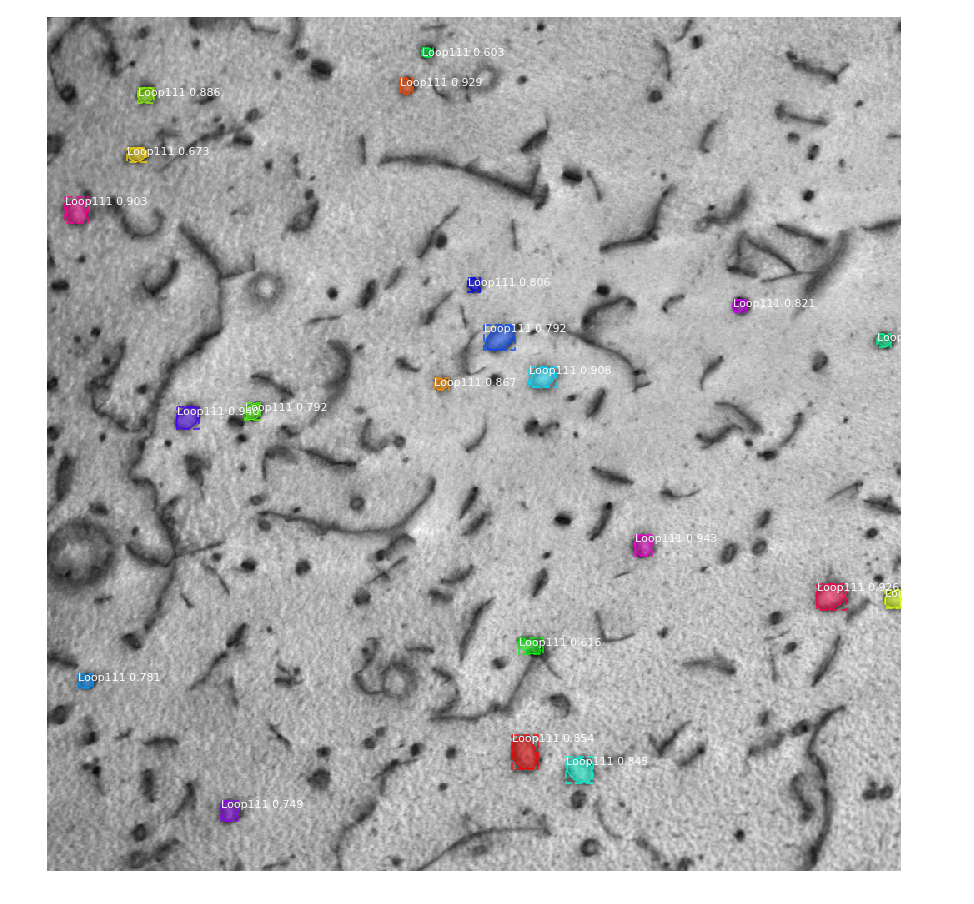

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI1_100kx_4200CL_foil1.txt
[[ 620  705  645  725]
 [ 467  155  493  182]
 [  72  423   91  438]
 [ 679  923  710  958]
 [ 418  578  443  610]
 [ 215   21  246   49]
 [  84  108  101  128]
 [ 432  464  446  482]
 [ 686 1005  708 1024]
 [ 860  557  901  588]
 [ 887  622  918  654]
 [ 338  823  353  839]
 [ 312  505  328  519]
 [ 368  524  398  561]
 [ 462  237  482  255]
 [ 787   37  804   55]
 [ 379  996  394 1012]
 [ 939  208  964  229]
 [ 155   95  172  118]
 [ 744  566  763  594]
 [  36  449   46  462]]
map1_70kx.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -122.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


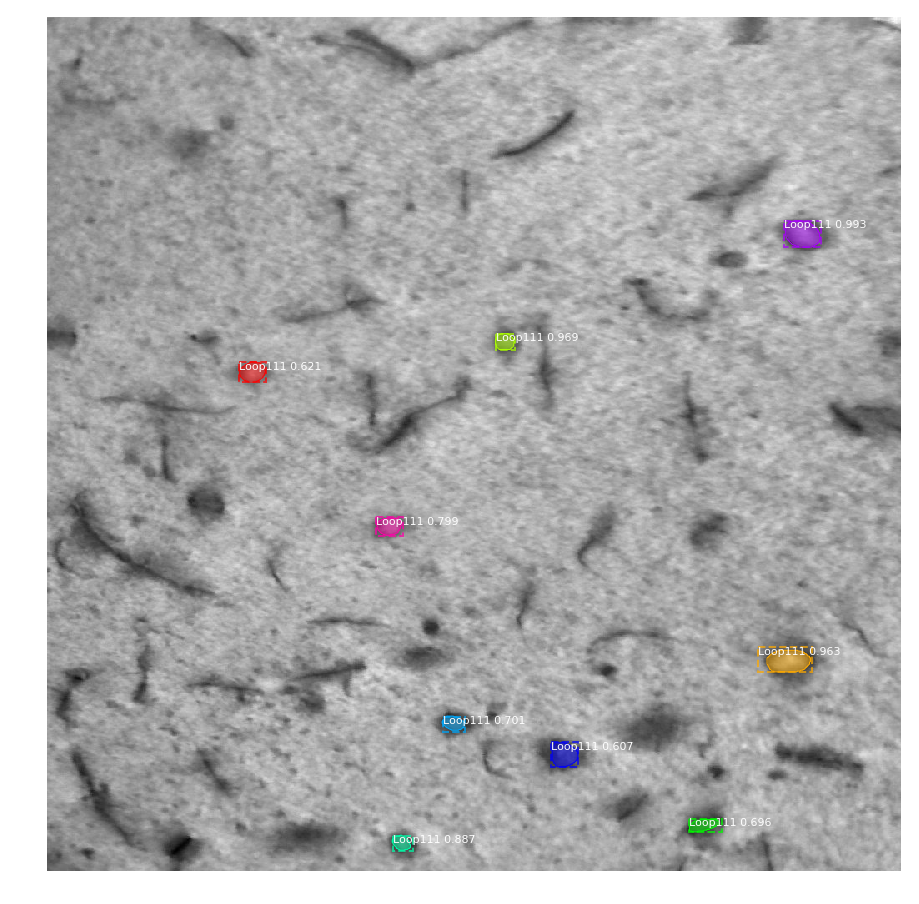

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map1_70kx.txt
[[243 884 275 928]
 [379 538 398 561]
 [755 853 785 917]
 [981 414 999 438]
 [599 394 621 426]
 [838 474 856 501]
 [961 770 977 809]
 [413 230 437 262]
 [869 604 899 637]]
ROI12_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


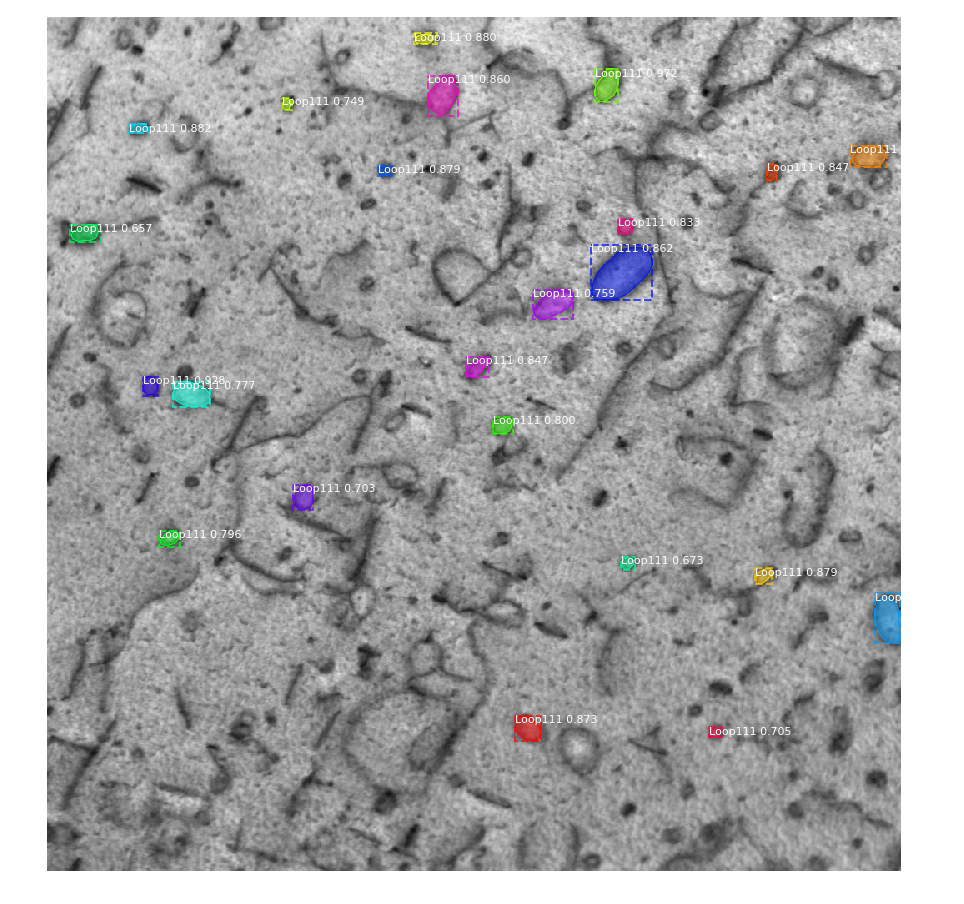

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI12_100kx_4200CL_foil1.txt
[[  61  657  100  685]
 [ 430  114  453  133]
 [ 127   98  138  121]
 [  18  440   31  467]
 [ 660  849  679  870]
 [ 177  397  189  413]
 [ 837  561  867  592]
 [ 272  652  338  726]
 [  69  457  117  492]
 [ 690  993  750 1023]
 [ 175  863  195  876]
 [ 406  502  430  530]
 [ 241  685  259  702]
 [ 478  534  499  558]
 [ 615  134  634  159]
 [ 436  150  466  195]
 [ 153  963  179 1008]
 [ 326  582  361  630]
 [  95  281  110  293]
 [ 851  794  863  809]
 [ 560  295  590  319]
 [ 646  688  662  705]
 [ 248   27  269   64]]
ROI6_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)   

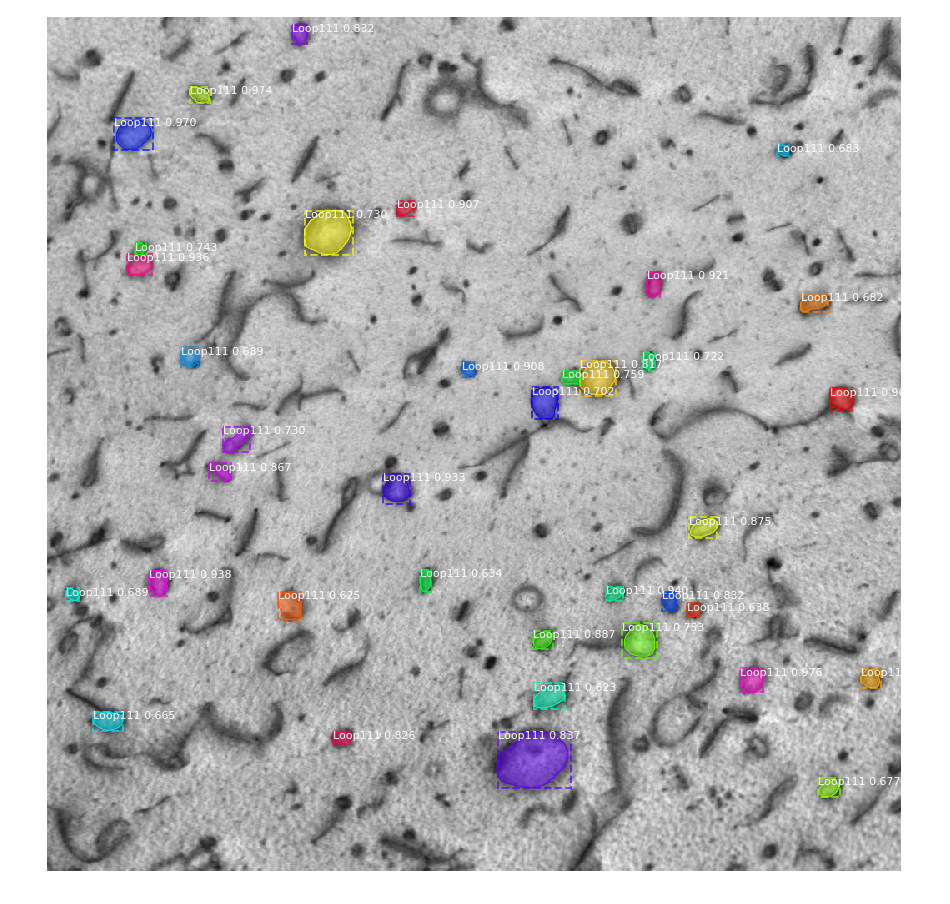

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI6_100kx_4200CL_foil1.txt
[[ 781  976  804 1000]
 [ 780  831  809  859]
 [  82  171  102  195]
 [ 120   80  158  126]
 [ 444  939  471  966]
 [ 682  670  699  691]
 [ 663  122  693  143]
 [ 283   95  308  125]
 [ 547  403  583  435]
 [ 304  719  335  735]
 [ 413  497  430  512]
 [ 219  419  237  440]
 [ 735  583  757  606]
 [ 599  770  624  804]
 [ 534  194  555  220]
 [ 856  540  924  628]
 [ 688  738  711  754]
 [   8  293   31  311]
 [ 856  343  871  363]
 [ 411  639  453  682]
 [ 423  617  439  640]
 [ 726  690  768  732]
 [ 270  105  284  118]
 [ 231  309  284  366]
 [ 490  211  521  243]
 [ 401  714  423  729]
 [ 443  581  481  613]
 [ 395  160  418  180]
 [ 684   22  699   38]
 [ 152  876  165  890]
 [ 331  904  352  937]
 [ 912  925  935  951]
 [ 832   54  855   91]
 [ 702  767  719  782]
 [ 662  447  689  460]
 [ 688  277  722  304]
 [ 798  584  829  621]]
map3_70kx_onzap_CL4100.jpg
Processing 1 images
image        

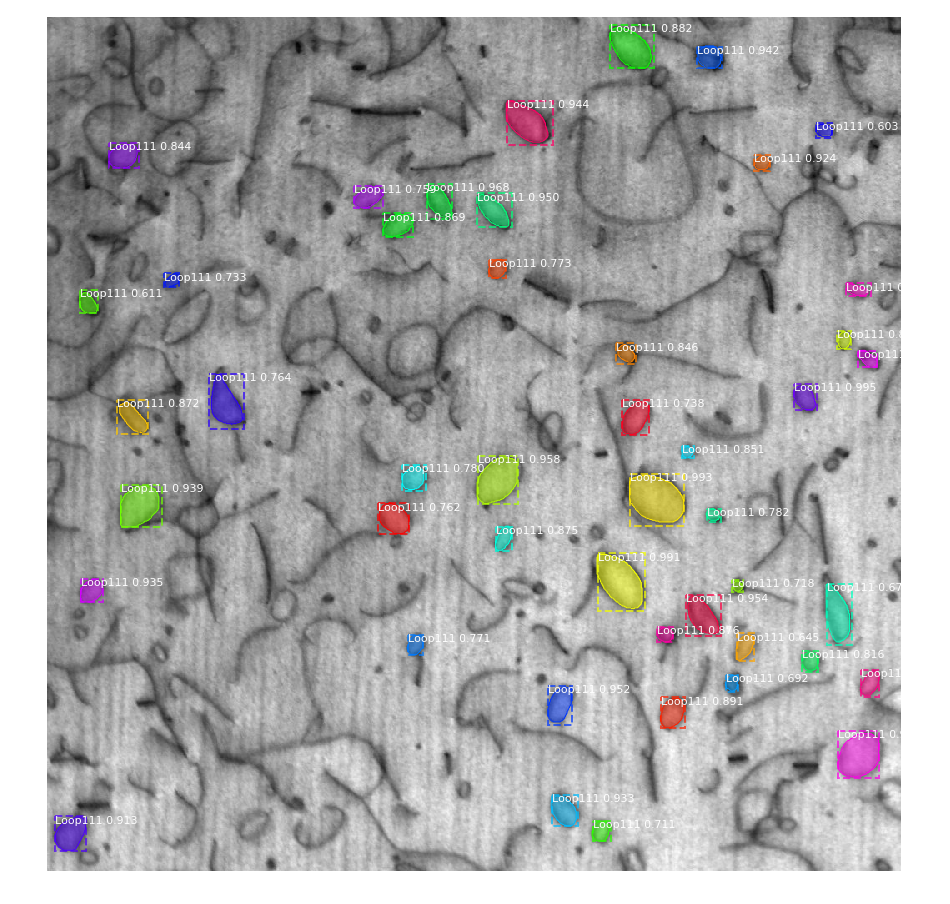

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map3_70kx_onzap_CL4100.txt
[[439 896 470 923]
 [547 699 609 764]
 [642 660 711 717]
 [199 455 241 485]
 [525 516 583 564]
 [692 766 741 808]
 [801 600 848 629]
 [210 515 250 557]
 [ 99 551 152 606]
 [ 34 780  60 809]
 [560  88 611 137]
 [673  40 701  67]
 [932 605 970 637]
 [855 949 912 998]
 [164 848 183 867]
 [958   9 999  46]
 [815 736 852 765]
 [375 948 397 964]
 [  8 675  60 728]
 [730 732 749 751]
 [610 538 639 557]
 [399 973 419 996]
 [458  83 499 120]
 [234 402 263 439]
 [513 761 528 776]
 [390 682 415 706]
 [149  74 180 110]
 [759 906 784 925]
 [589 791 604 808]
 [536 425 567 454]
 [318 958 333 988]
 [290 530 312 550]
 [740 432 764 451]
 [427 194 493 236]
 [582 396 619 434]
 [201 368 228 403]
 [782 976 815 998]
 [458 689 500 722]
 [306 140 323 158]
 [674 822 688 835]
 [963 654 988 676]
 [788 814 809 829]
 [679 935 752 965]
 [738 827 771 848]
 [326  39 354  61]
 [125 922 143 942]]
ROI15_100kx_4200CL_foil1.jpg
Processin

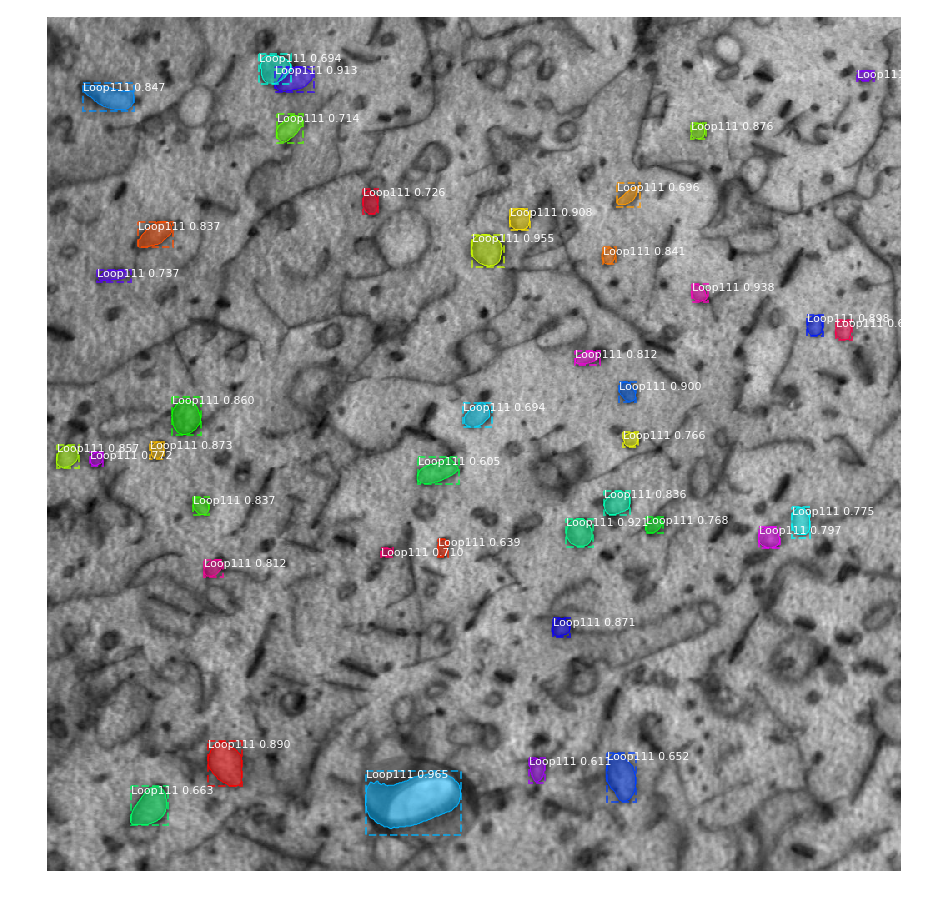

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI15_100kx_4200CL_foil1.txt
[[903 382 980 496]
 [260 509 298 548]
 [319 773 340 793]
 [601 622 634 654]
 [ 58 273  88 320]
 [229 555 254 579]
 [437 686 460 706]
 [356 912 381 931]
 [867 193 922 233]
 [125 772 145 790]
 [508 123 529 140]
 [720 606 742 627]
 [454 149 500 184]
 [512  11 540  38]
 [ 78  43 111 104]
 [275 666 295 682]
 [574 175 596 194]
 [245 109 275 150]
 [567 668 596 699]
 [650 188 670 211]
 [399 633 416 663]
 [610 854 636 879]
 [587 893 624 915]
 [520  51 537  67]
 [598 718 618 739]
 [496 691 514 709]
 [ 63 972  75 992]
 [302  59 316 100]
 [205 379 235 397]
 [115 275 149 306]
 [636 400 646 414]
 [198 684 226 711]
 [ 43 254  79 292]
 [462 499 491 533]
 [362 946 386 966]
 [922 100 968 144]
 [882 671 941 706]
 [625 468 646 480]
 [888 578 918 597]
 [527 444 559 494]]
ROI5_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_i

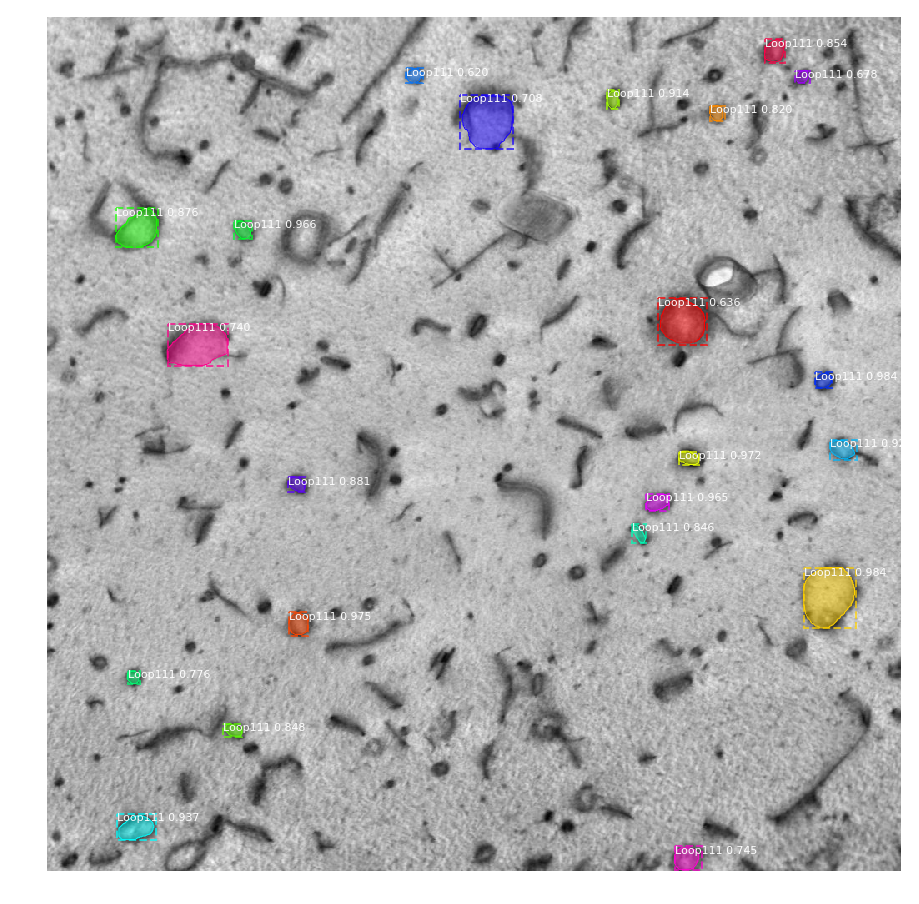

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI5_100kx_4200CL_foil1.txt
[[ 660  908  732  970]
 [ 425  921  444  941]
 [ 713  290  741  313]
 [ 520  758  536  782]
 [ 243  224  265  245]
 [ 571  718  591  746]
 [ 955   83  986  130]
 [ 506  939  530  972]
 [  86  671  109  686]
 [ 551  289  568  309]
 [ 228   82  275  133]
 [  25  861   53  885]
 [ 847  211  862  233]
 [ 607  702  630  718]
 [ 105  795  123  813]
 [ 783   96  799  111]
 [ 994  753 1022  785]
 [ 367  144  417  217]
 [  92  495  157  559]
 [  63  897   78  915]
 [ 336  733  392  791]
 [  60  430   78  450]]
map9_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max

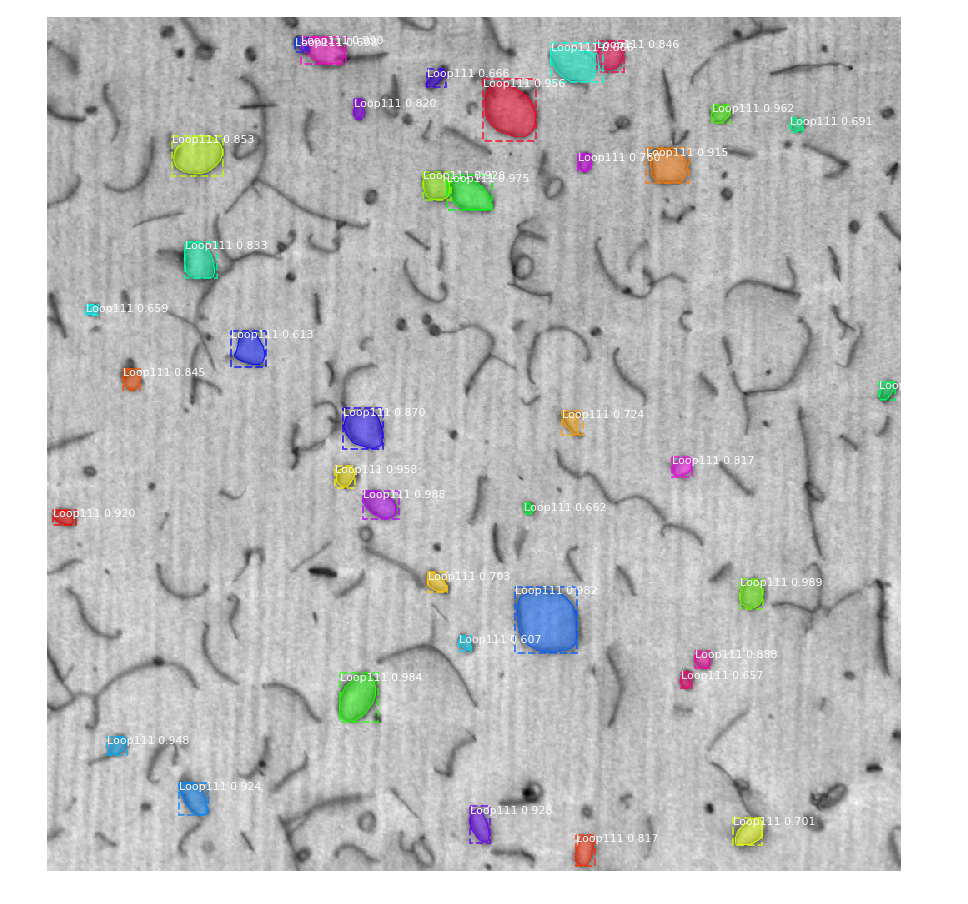

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map9_70kx_onzap_CL4100.txt
[[  22  304   55  358]
 [ 673  831  709  859]
 [ 567  379  601  422]
 [ 786  351  844  396]
 [ 682  561  762  635]
 [ 188  479  230  533]
 [ 104  797  126  819]
 [ 537  345  564  369]
 [  73  522  147  586]
 [ 862   71  884   95]
 [ 184  450  218  484]
 [ 946  507  990  531]
 [ 918  158  956  193]
 [ 590    7  608   34]
 [ 156  718  198  770]
 [ 759  777  780  795]
 [ 436  998  458 1017]
 [ 468  355  517  402]
 [ 141  149  189  211]
 [  27  659   64  692]
 [ 421   90  446  111]
 [ 268  165  312  203]
 [  97  368  121  380]
 [ 980  634 1018  657]
 [ 526  749  550  774]
 [ 163  637  183  652]
 [ 471  617  500  642]
 [ 665  456  689  479]
 [ 960  823  992  858]
 [ 119  891  136  907]
 [  30  604   76  666]
 [  61  455   82  478]
 [ 582  572  595  583]
 [ 344   46  356   61]
 [ 784  760  804  773]
 [ 375  220  419  262]
 [  24  297   40  312]
 [ 741  494  759  508]]
K713_300kx_store4_grid1_0031.jpg
Proce

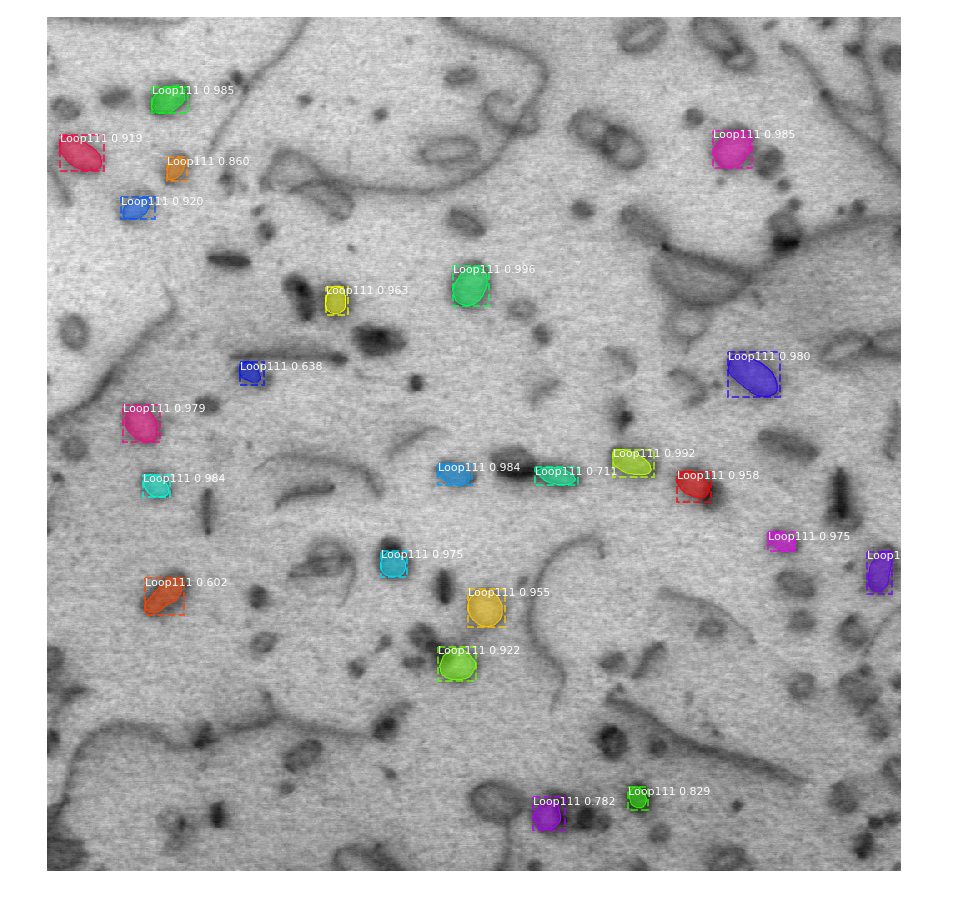

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/K713_300kx_store4_grid1_0031.txt
[[ 297  487  345  530]
 [ 518  679  551  728]
 [  82  125  114  168]
 [ 135  799  180  845]
 [ 535  469  560  509]
 [ 548  114  575  147]
 [ 401  817  455  879]
 [ 464   91  509  135]
 [ 639  400  670  431]
 [ 617  865  639  897]
 [ 322  334  356  360]
 [ 544  755  580  796]
 [ 685  505  731  549]
 [ 754  469  795  514]
 [ 215   88  241  129]
 [ 140   15  183   68]
 [ 167  143  195  167]
 [ 923  697  950  721]
 [ 935  583  974  621]
 [ 640  984  691 1014]
 [ 539  585  560  637]
 [ 413  231  440  260]
 [ 672  117  716  164]]
map1_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)

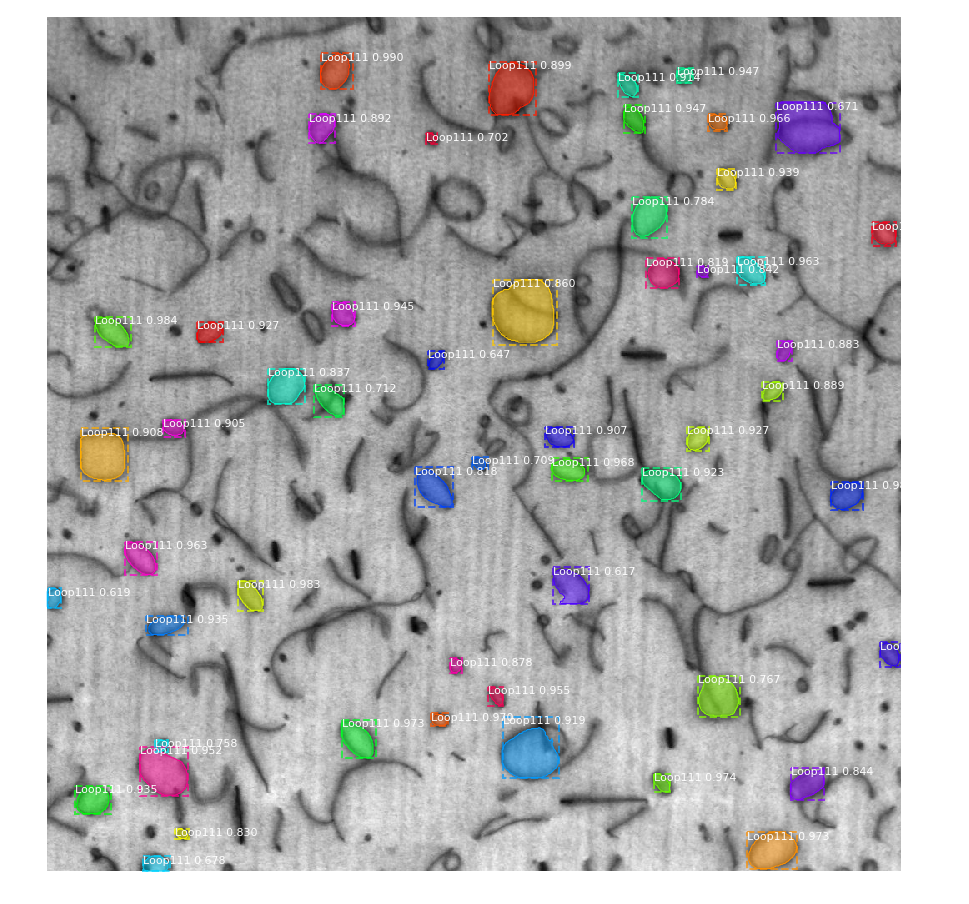

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map1_70kx_onzap_CL4100.txt
[[  42  328   85  366]
 [ 358   57  394  100]
 [ 675  229  711  259]
 [ 556  940  590  979]
 [ 907  728  929  747]
 [ 842  353  888  394]
 [ 977  840 1021  900]
 [ 834  460  849  481]
 [ 528  605  555  648]
 [ 115  793  135  816]
 [ 628   93  668  131]
 [ 287  828  320  861]
 [ 749  999  779 1023]
 [ 802  529  825  547]
 [ 874  111  933  168]
 [  59  755   78  775]
 [ 104  692  138  717]
 [ 341  341  369  369]
 [ 181  803  206  826]
 [ 717  118  740  169]
 [ 921   33  955   76]
 [ 364  179  389  210]
 [ 490  767  519  794]
 [ 540  714  579  760]
 [ 838  546  912  614]
 [  66  685   94  709]
 [ 492   40  555   96]
 [ 490  597  515  632]
 [ 482  139  502  165]
 [  52  530  116  586]
 [ 115  314  150  345]
 [ 436  857  459  883]
 [ 387  875  411  894]
 [ 768  483  786  497]
 [ 314  534  392  611]
 [ 900  892  938  932]
 [ 297  780  311  793]
 [ 421  265  463  309]
 [ 973  153  985  170]
 [ 288  718  324

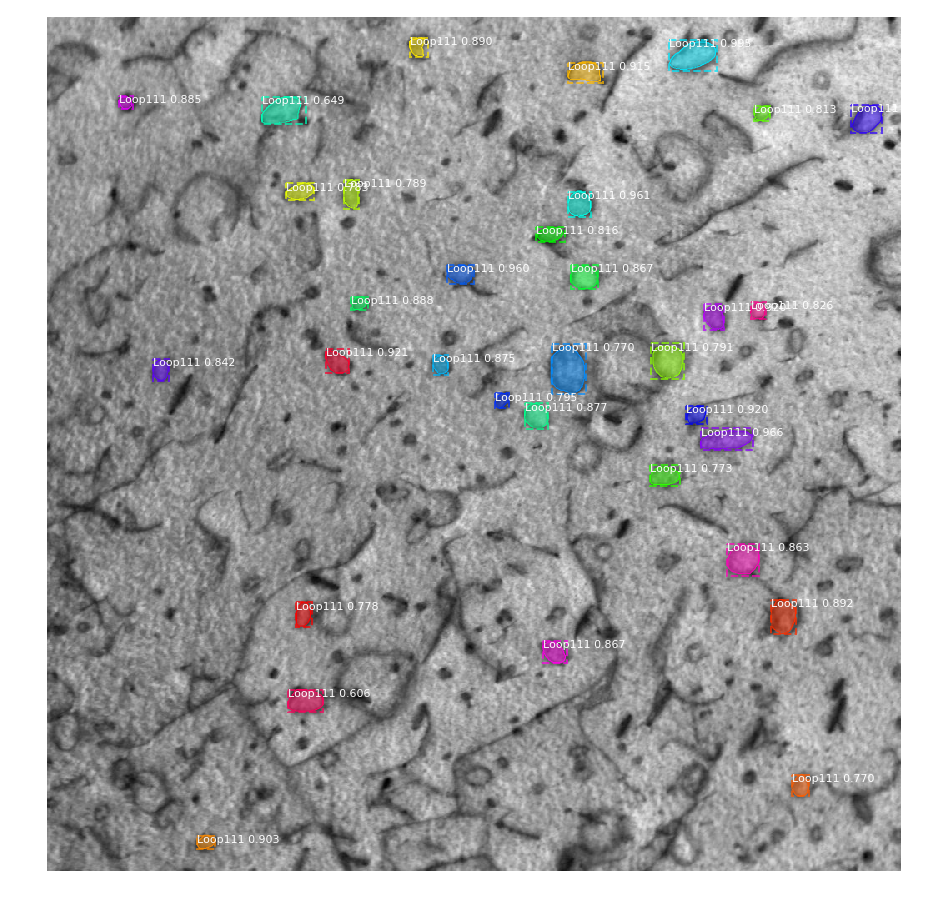

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI8_100kx_4200CL_foil1.txt
[[  26  746   63  804]
 [ 492  784  518  847]
 [ 208  625  238  652]
 [ 296  479  319  512]
 [ 104  964  137 1002]
 [ 397  334  426  362]
 [ 465  766  487  792]
 [ 343  788  374  812]
 [  53  624   78  666]
 [ 981  179  997  201]
 [ 698  868  739  898]
 [  23  435   46  457]
 [ 334  364  350  384]
 [  93   86  109  102]
 [ 462  573  493  601]
 [ 404  462  428  481]
 [ 296  628  325  661]
 [ 747  594  774  623]
 [ 631  816  669  854]
 [ 409  127  435  146]
 [ 340  844  361  862]
 [ 250  586  268  621]
 [ 105  848  123  867]
 [ 450  537  468  554]
 [ 390  724  433  764]
 [ 194  356  229  374]
 [ 198  286  218  320]
 [ 701  298  730  317]
 [ 536  723  561  759]
 [ 908  894  934  914]
 [ 391  605  451  646]
 [  94  257  127  310]
 [ 806  288  833  331]]
K713_300kx_store4_grid1_0033.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molde

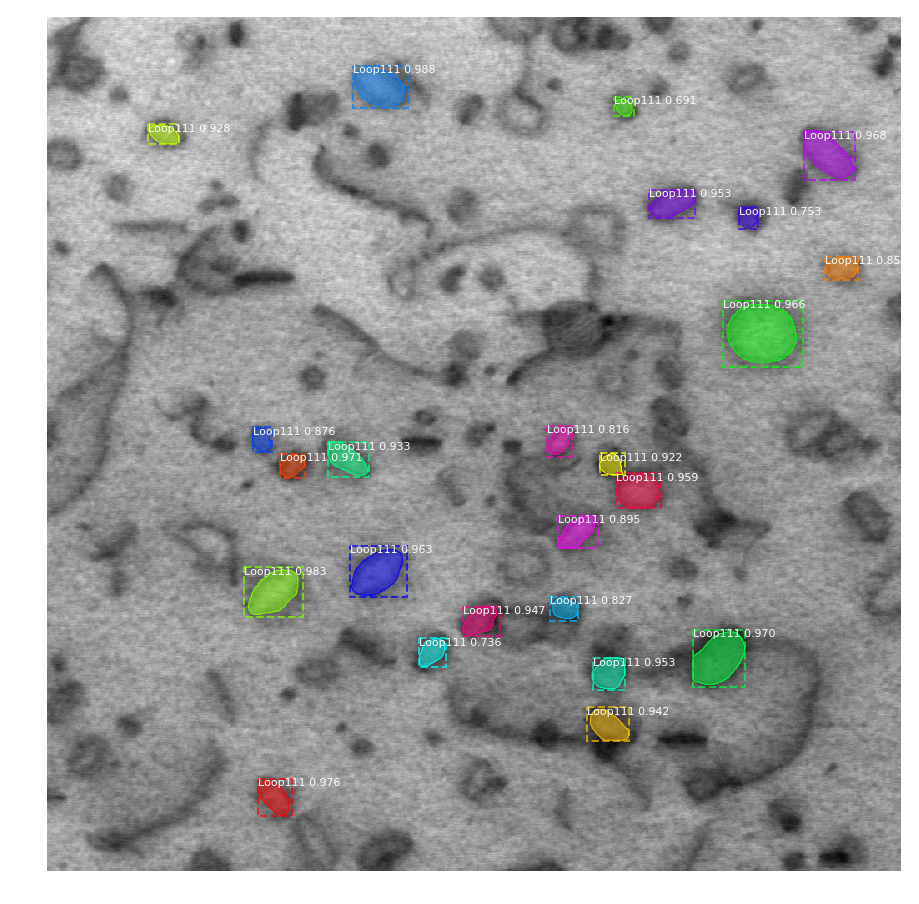

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/K713_300kx_store4_grid1_0033.txt
[[ 57 366 107 433]
 [659 236 718 307]
 [913 252 957 293]
 [523 279 552 309]
 [734 775 802 837]
 [136 908 194 969]
 [339 811 419 907]
 [633 363 694 431]
 [546 682 588 736]
 [206 722 240 777]
 [768 654 806 693]
 [706 499 741 543]
 [827 647 867 698]
 [509 337 551 386]
 [127 120 151 158]
 [522 663 548 693]
 [597 613 636 661]
 [491 246 520 269]
 [286 933 314 973]
 [694 603 723 637]
 [489 599 526 629]
 [227 830 253 853]
 [744 446 778 478]
 [ 94 680 117 704]]
ROI2_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -119.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


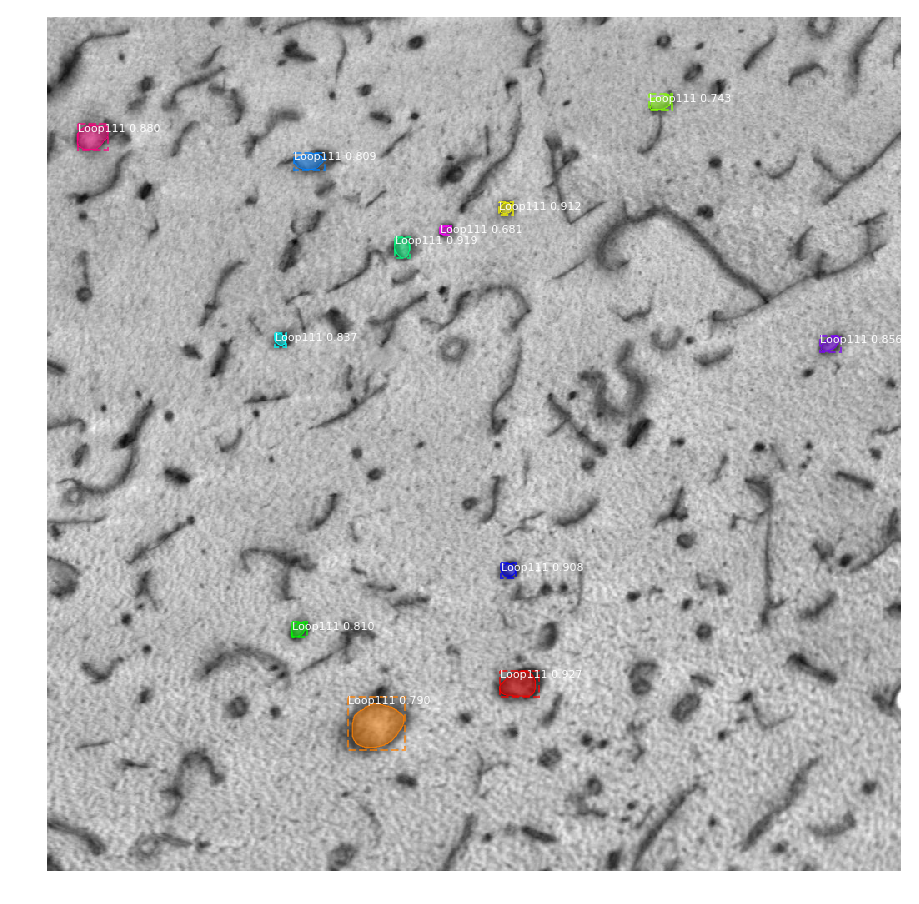

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI2_100kx_4200CL_foil1.txt
[[783 543 814 590]
 [262 417 288 435]
 [221 542 236 558]
 [654 544 672 562]
 [127  36 158  73]
 [381 927 400 952]
 [378 273 394 286]
 [725 293 743 311]
 [161 296 182 333]
 [814 361 878 429]
 [ 91 722 110 750]
 [249 471 260 484]]
ROI11_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -122.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


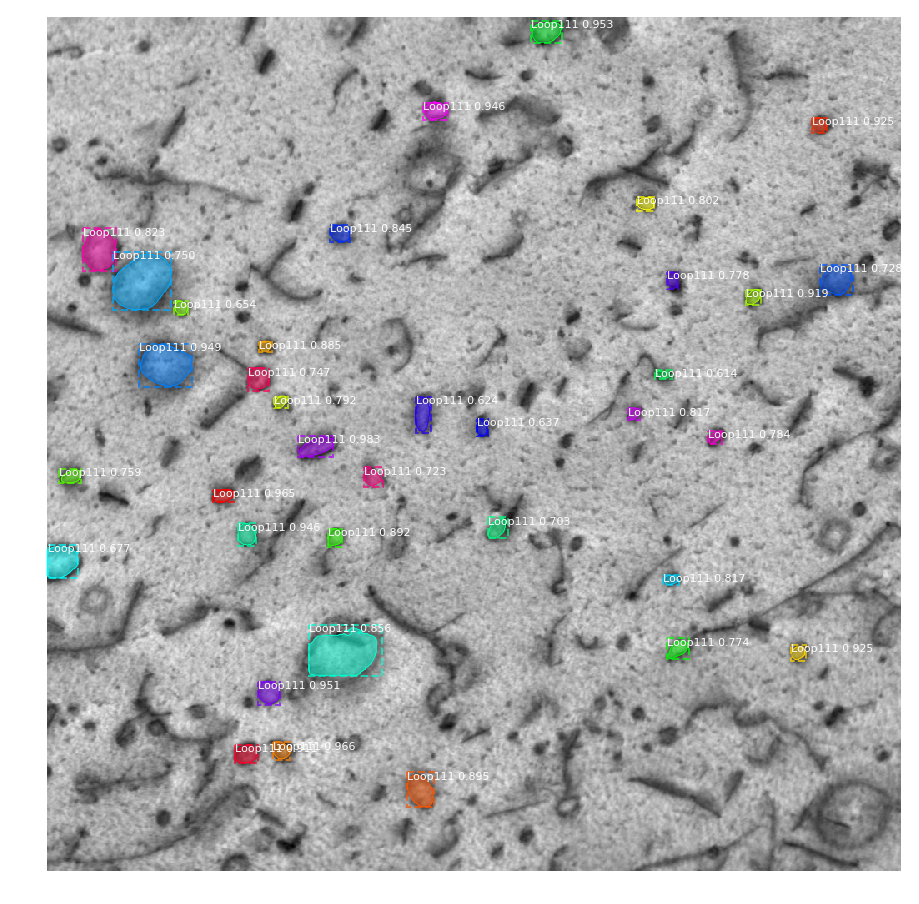

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI11_100kx_4200CL_foil1.txt
[[501 301 526 343]
 [869 270 890 291]
 [566 198 581 224]
 [  3 580  29 617]
 [796 253 824 279]
 [391 110 442 173]
 [101 451 122 480]
 [606 229 633 250]
 [752 892 771 910]
 [119 918 137 936]
 [326 838 344 856]
 [872 225 894 252]
 [905 431 947 464]
 [613 336 634 353]
 [388 254 401 269]
 [728 314 789 401]
 [248 339 268 363]
 [252  42 303  82]
 [668 739 680 758]
 [468 697 482 711]
 [214 708 231 728]
 [454 272 468 289]
 [495 793 511 809]
 [304 744 325 757]
 [744 744 769 770]
 [541  14 558  40]
 [280  79 350 148]
 [420 241 447 266]
 [296 927 332 967]
 [539 380 562 402]
 [599 529 624 552]
 [632   0 672  36]
 [339 152 356 169]
 [481 515 501 529]
 [454 442 498 460]
 [422 729 433 750]]
ROI10_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10

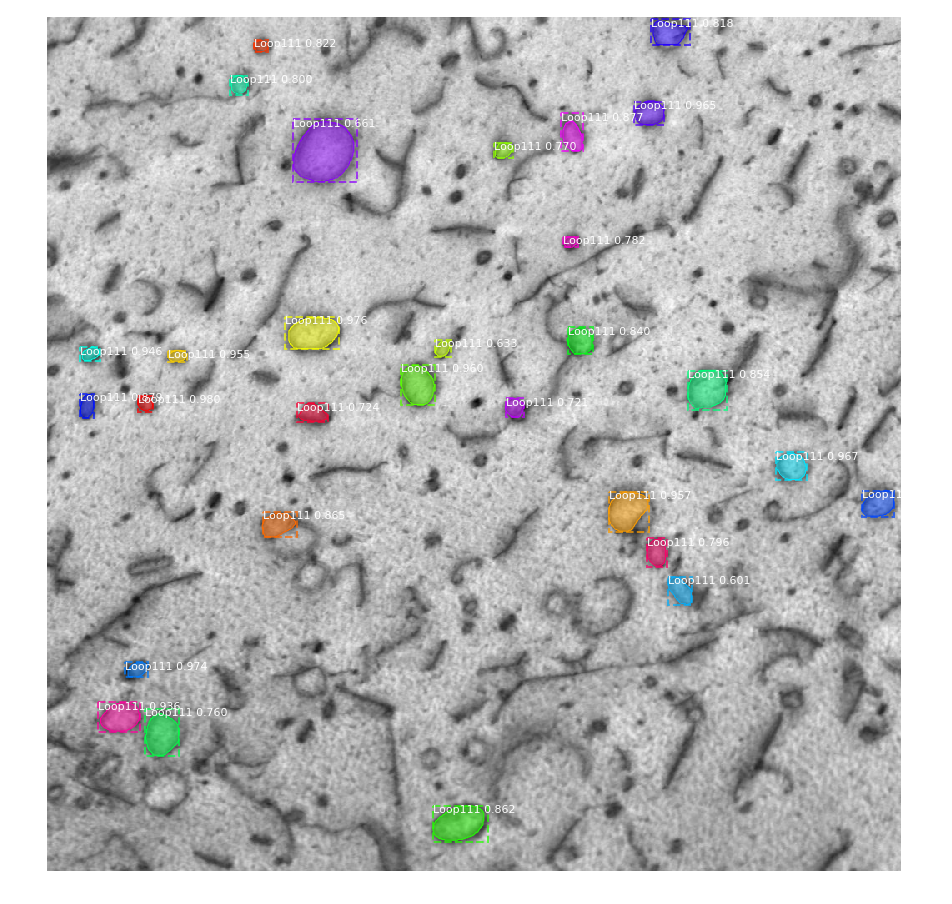

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI10_100kx_4200CL_foil1.txt
[[ 453  109  472  127]
 [ 358  285  397  350]
 [ 773   93  791  121]
 [ 521  874  554  911]
 [ 100  704  128  740]
 [ 416  424  464  465]
 [ 568  674  616  722]
 [ 399  145  412  167]
 [ 395   39  411   63]
 [ 821   61  856  111]
 [ 451   39  480   56]
 [ 114  616  159  642]
 [ 592  258  623  299]
 [ 945  462  989  528]
 [ 423  769  470  815]
 [ 371  624  403  655]
 [ 567  978  599 1016]
 [  26  248   40  265]
 [   1  724   32  771]
 [  69  219   92  240]
 [ 624  719  659  743]
 [ 262  619  275  637]
 [ 149  536  168  559]
 [ 829  117  885  158]
 [ 462  299  485  336]
 [ 456  550  479  572]
 [ 121  295  197  371]
 [ 386  465  407  484]
 [ 670  745  704  773]]
map7_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_

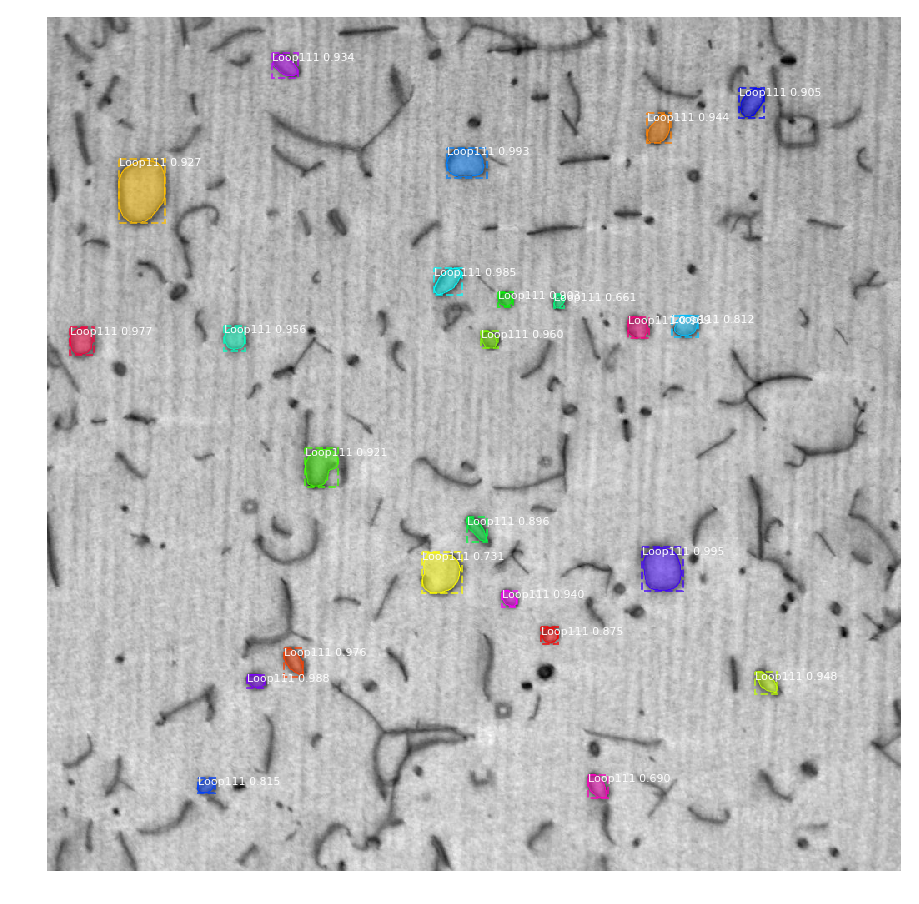

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map7_70kx_onzap_CL4100.txt
[[635 714 687 763]
 [155 479 192 527]
 [358 697 384 722]
 [788 239 804 261]
 [300 464 332 497]
 [371  27 404  56]
 [756 284 790 307]
 [375 520 396 540]
 [369 212 399 237]
 [785 849 811 876]
 [114 719 149 748]
 [687 545 706 563]
 [ 42 269  71 301]
 [169  86 246 141]
 [516 309 563 349]
 [ 84 830 120 860]
 [328 541 346 558]
 [599 503 629 527]
 [731 592 751 613]
 [912 180 930 201]
 [357 750 383 781]
 [641 449 690 497]
 [908 649 936 673]
 [331 608 348 620]]
ROI3_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


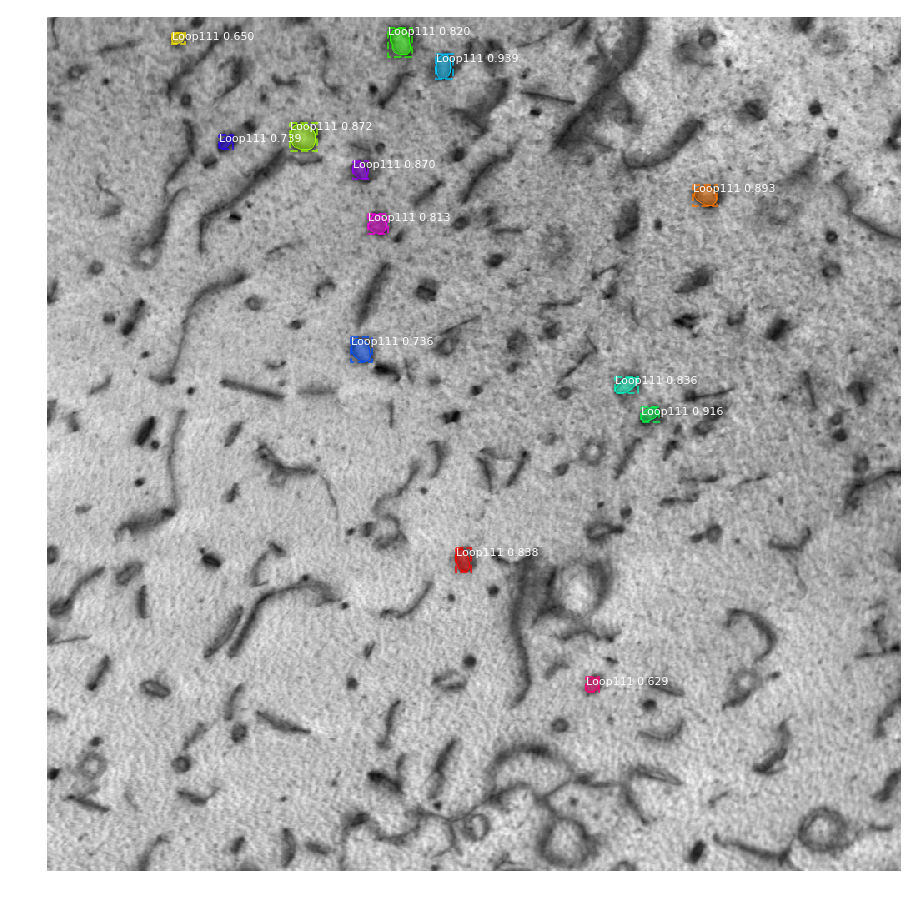

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI3_100kx_4200CL_foil1.txt
[[ 43 466  73 486]
 [467 712 484 734]
 [200 775 225 804]
 [125 291 159 323]
 [171 366 193 385]
 [636 490 665 508]
 [430 681 450 709]
 [ 11 409  46 437]
 [235 385 259 408]
 [140 206 157 223]
 [383 364 413 389]
 [ 17 149  31 165]
 [791 646 809 662]]
ROI9_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


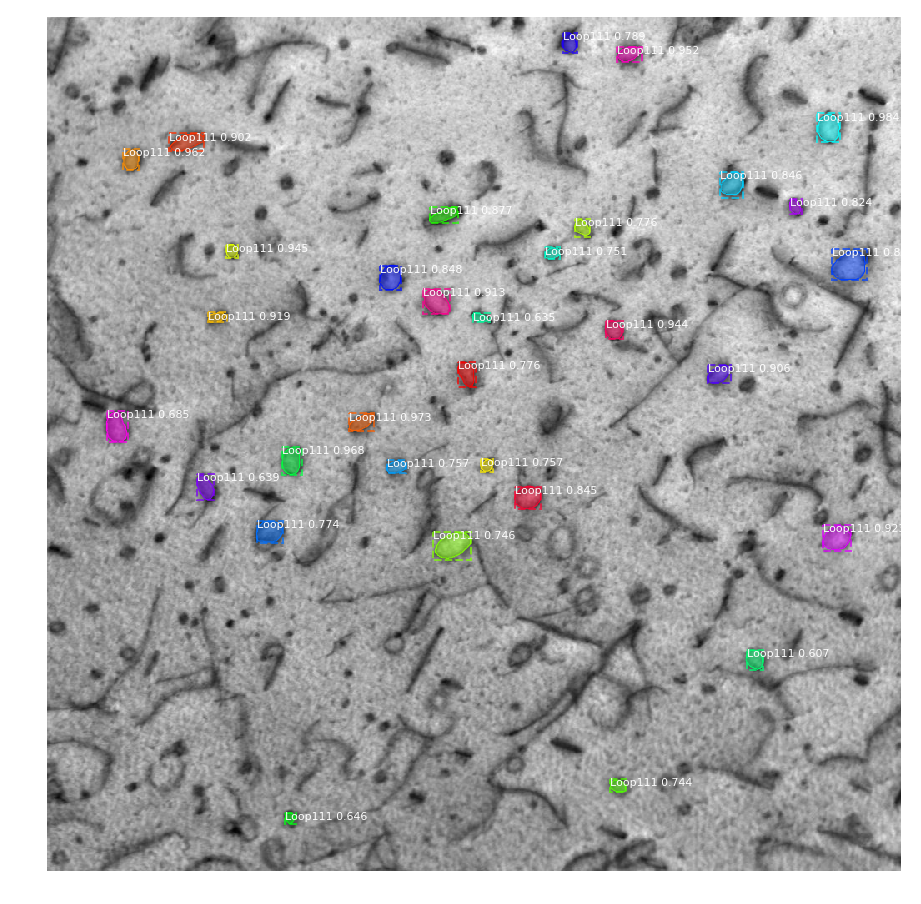

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI9_100kx_4200CL_foil1.txt
[[114 924 148 951]
 [474 362 495 392]
 [514 281 548 305]
 [157  91 182 110]
 [ 34 684  52 713]
 [272 214 288 228]
 [363 670 385 691]
 [608 931 639 964]
 [353 192 365 215]
 [325 451 355 483]
 [416 793 438 820]
 [138 146 159 188]
 [277 941 314 983]
 [226 459 246 492]
 [297 399 326 424]
 [184 807 216 835]
 [562 561 589 592]
 [217 891 235 905]
 [ 17 618  41 635]
 [412 492 443 514]
 [241 633 262 651]
 [603 251 630 283]
 [530 407 546 430]
 [529 520 545 535]
 [275 597 289 615]
 [616 462 650 508]
 [913 675 929 694]
 [471  71 509  96]
 [954 285 967 298]
 [547 179 578 200]
 [354 510 365 531]
 [758 839 782 859]]
ROI4_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.0

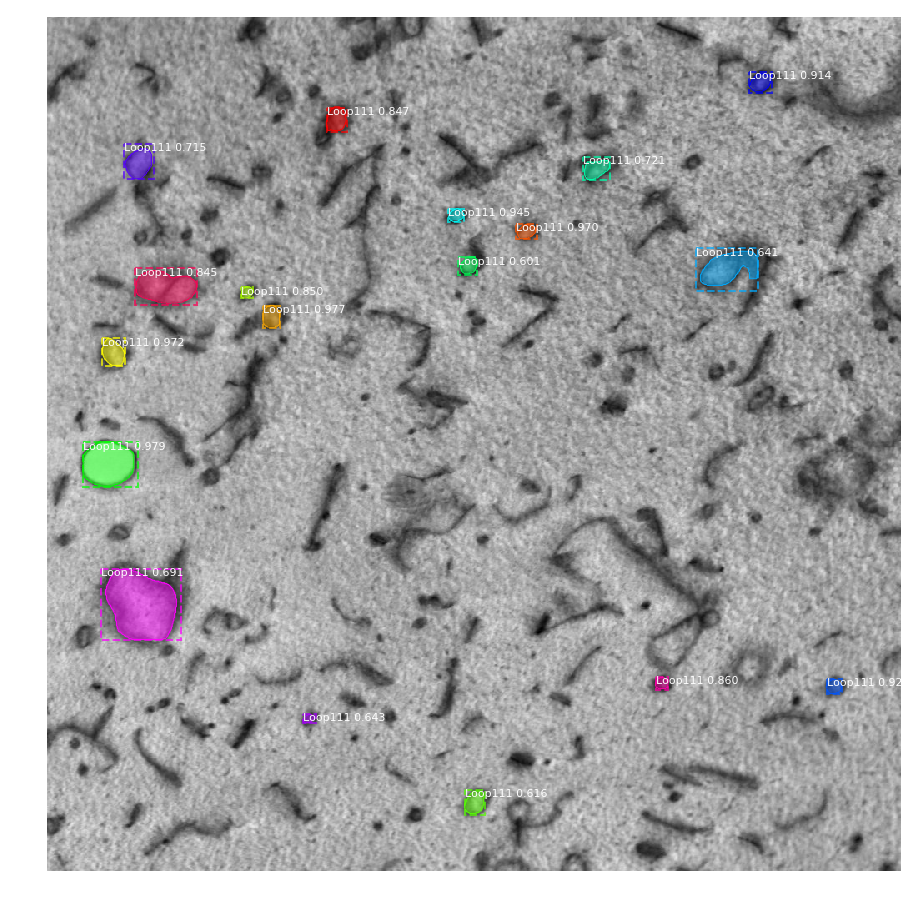

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI4_100kx_4200CL_foil1.txt
[[509  43 562 108]
 [345 259 372 279]
 [384  65 417  93]
 [247 562 265 587]
 [229 481 244 500]
 [793 935 811 954]
 [ 64 842  89 870]
 [790 730 806 745]
 [323 232 336 247]
 [107 335 136 359]
 [300 105 344 179]
 [166 642 194 675]
 [151  92 193 128]
 [661  64 746 160]
 [835 306 846 322]
 [276 778 327 853]
 [926 501 956 525]
 [287 493 308 515]]
map5_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


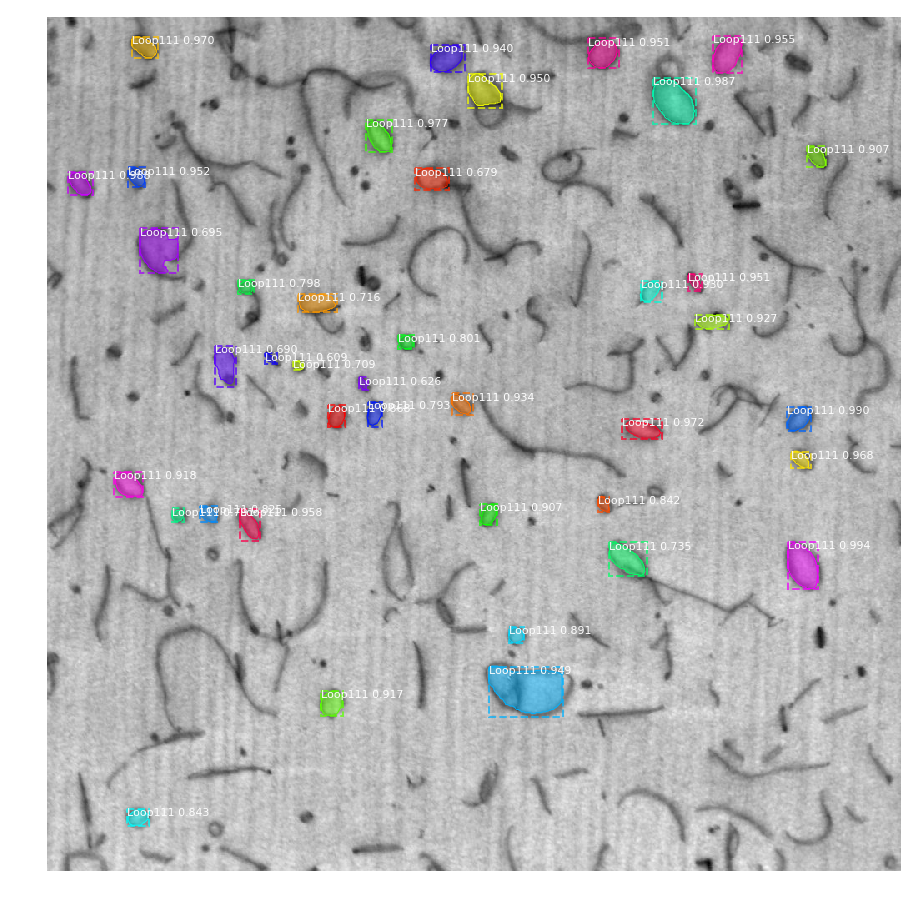

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map5_70kx_onzap_CL4100.txt
[[628 889 685 925]
 [466 888 495 916]
 [184  25 212  54]
 [ 71 727 127 778]
 [122 382 160 413]
 [481 690 505 738]
 [ 22 101  47 132]
 [520 892 540 916]
 [589 231 627 255]
 [ 21 799  65 833]
 [179  96 203 117]
 [307 769 327 785]
 [ 24 649  60 686]
 [ 67 504 107 545]
 [778 530 839 618]
 [ 32 460  64 501]
 [450 485 476 510]
 [315 712 340 737]
 [356 777 373 818]
 [544  80 574 115]
 [807 328 837 354]
 [583 519 608 539]
 [153 912 179 934]
 [730 554 750 572]
 [464 337 491 357]
 [949  95 969 122]
 [574 660 593 674]
 [585 183 605 203]
 [380 421 397 440]
 [314 229 331 248]
 [460 384 490 401]
 [588 149 604 164]
 [629 674 669 720]
 [331 301 353 347]
 [411 295 422 307]
 [252 111 306 157]
 [393 201 442 226]
 [180 441 206 482]
 [431 374 446 384]
 [402 261 415 275]]
ROI14_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_im

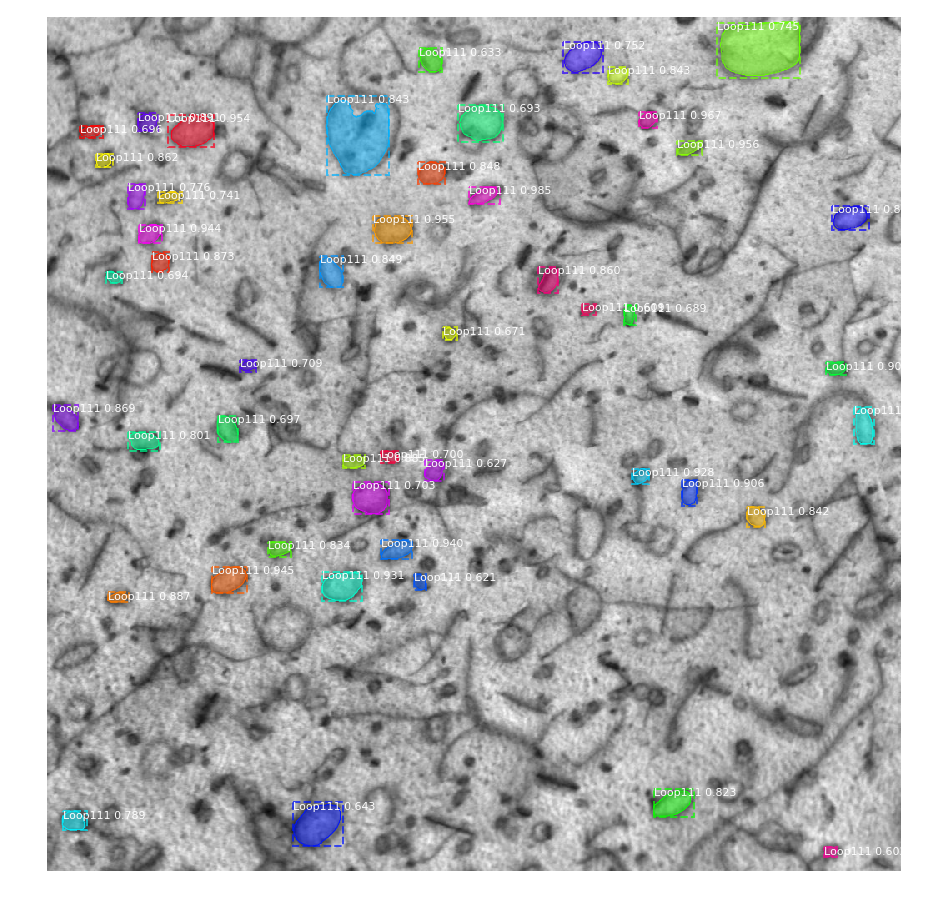

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI14_100kx_4200CL_foil1.txt
[[ 202  506  223  543]
 [ 112  710  131  731]
 [ 147  755  164  786]
 [ 237  391  270  437]
 [ 116  145  154  200]
 [ 658  197  690  239]
 [ 248  110  270  137]
 [ 626  400  649  437]
 [ 664  329  699  377]
 [ 541  702  559  722]
 [ 554  761  585  780]
 [ 413  934  428  958]
 [ 114  108  135  132]
 [ 689   72  701   98]
 [ 524  354  540  381]
 [ 225  942  254  986]
 [ 281  125  304  146]
 [ 464    7  495   37]
 [ 163   58  179   78]
 [ 298  589  330  613]
 [ 285  327  323  354]
 [ 173  444  199  477]
 [  58  672   79  697]
 [  93  335  188  410]
 [ 587  840  610  861]
 [ 628  265  646  292]
 [ 925  728  959  776]
 [ 466  968  511  992]
 [ 496   96  519  135]
 [ 952   18  974   47]
 [ 199   97  229  117]
 [  28  619   65  667]
 [   5  803   71  903]
 [ 208  132  222  161]
 [ 410  231  424  250]
 [ 556  366  595  410]
 [ 519  400  534  421]
 [ 477  204  509  229]
 [ 129   39  143   66]
 [ 304   70  3

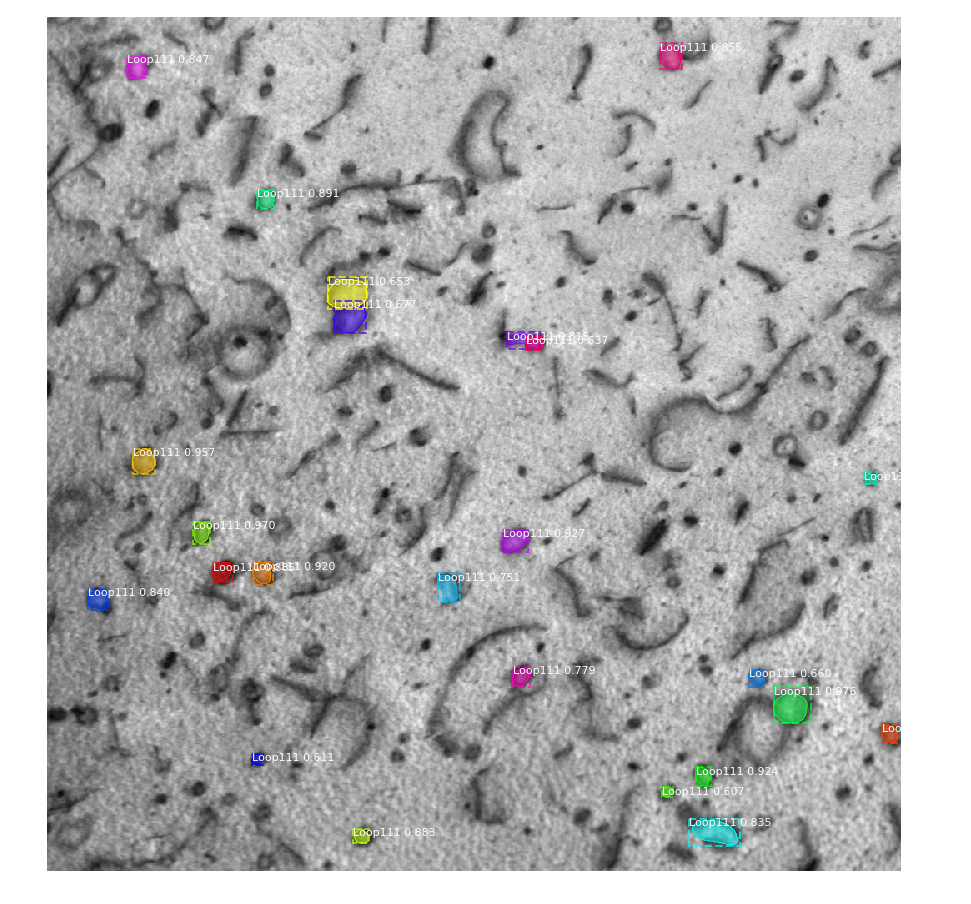

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI7_100kx_4200CL_foil1.txt
[[ 803  872  846  916]
 [ 604  175  631  195]
 [ 517  102  547  129]
 [ 614  546  641  576]
 [ 899  778  922  796]
 [ 653  246  680  270]
 [ 206  251  229  272]
 [ 654  199  676  222]
 [ 973  367  990  386]
 [  30  735   61  761]
 [  45   95   72  119]
 [ 685   49  710   74]
 [ 961  770  993  831]
 [ 377  551  397  591]
 [ 778  558  803  579]
 [ 666  468  700  495]
 [ 848 1001  870 1020]
 [ 339  344  378  382]
 [ 545  980  559  996]
 [ 782  842  802  860]
 [ 311  336  349  383]
 [ 382  574  398  594]
 [ 883  245  896  259]
 [ 923  737  935  751]]
ROI13_100kx_4200CL_foil1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  s

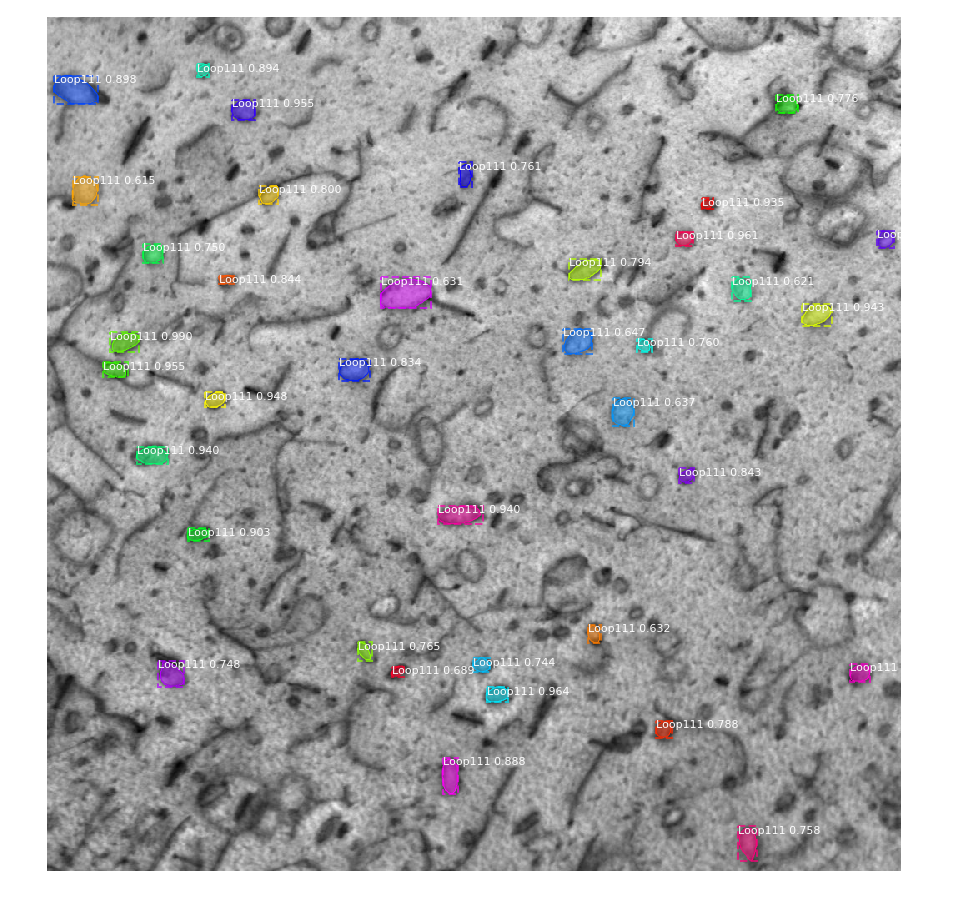

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/ROI13_100kx_4200CL_foil1.txt
[[ 377   75  400  110]
 [ 775  963  796  987]
 [ 803  527  821  553]
 [ 256  754  273  775]
 [  98  221  122  249]
 [ 413   67  431   96]
 [ 449  189  467  213]
 [ 343  906  369  941]
 [ 585  469  607  523]
 [ 514  107  535  145]
 [ 216  785  229  799]
 [ 612  168  627  194]
 [  69    8  103   61]
 [  55  179   70  194]
 [ 888  474  931  493]
 [ 309  206  319  224]
 [ 540  758  558  776]
 [ 409  350  435  387]
 [ 201  254  223  277]
 [ 289  626  314  664]
 [ 843  730  864  749]
 [  92  874  114  901]
 [ 749  372  771  389]
 [ 173  494  203  509]
 [ 385  708  401  725]
 [ 970  829 1011  852]
 [ 271  115  294  139]
 [ 255  996  276 1016]
 [ 771  132  802  164]
 [ 768  511  785  531]
 [ 778  413  790  428]
 [ 373  619  403  653]
 [ 456  678  489  704]
 [ 728  649  750  664]
 [ 311  400  348  460]
 [ 311  822  339  844]
 [ 190   30  224   60]]
map2_70kx.jpg
Processing 1 images
image                    

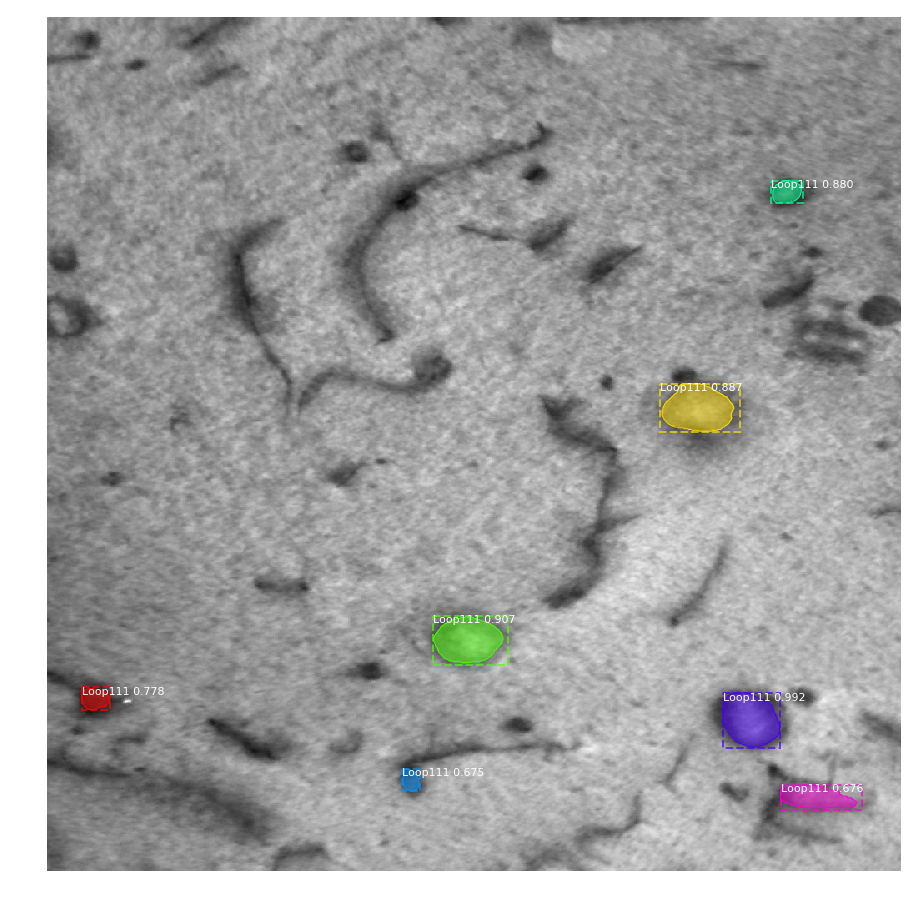

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map2_70kx.txt
[[810 811 876 879]
 [717 463 776 552]
 [439 735 496 831]
 [195 868 222 907]
 [803  41 830  75]
 [920 880 950 978]
 [901 425 928 447]]
map3_70kx.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -119.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


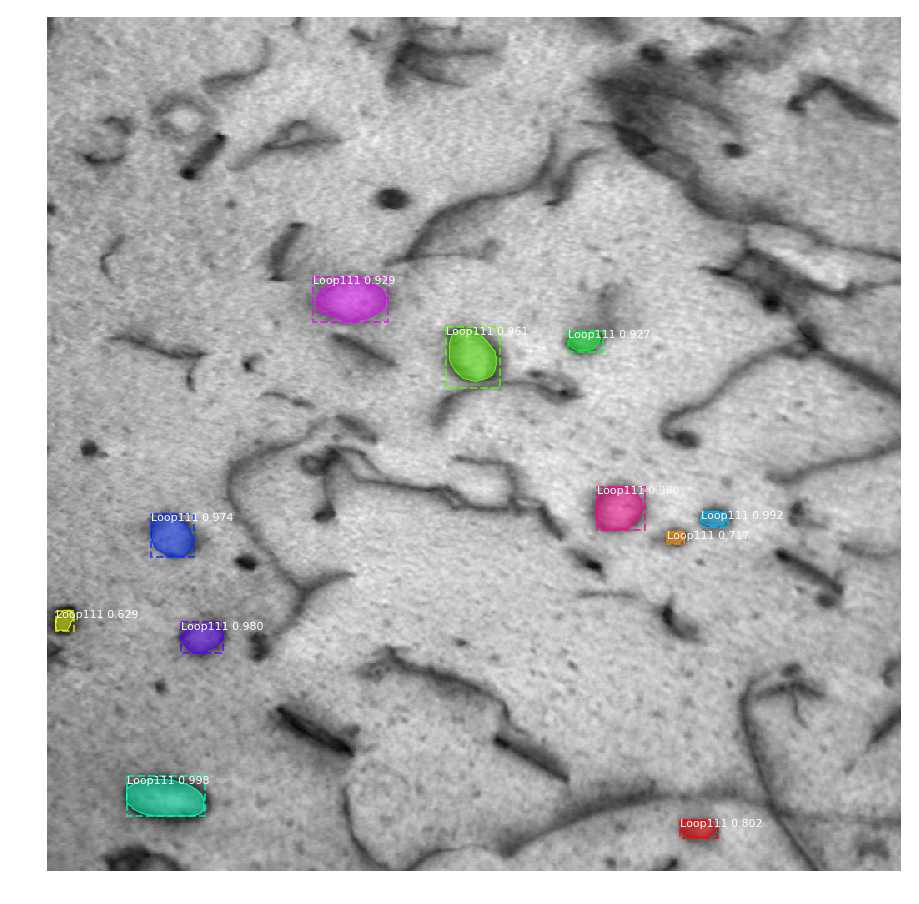

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map3_70kx.txt
[[910  95 958 189]
 [592 784 610 817]
 [725 160 762 211]
 [562 659 614 717]
 [595 124 646 176]
 [371 478 444 543]
 [310 319 364 409]
 [375 625 400 666]
 [962 759 984 805]
 [616 743 631 764]
 [711  10 735  32]]
map8_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


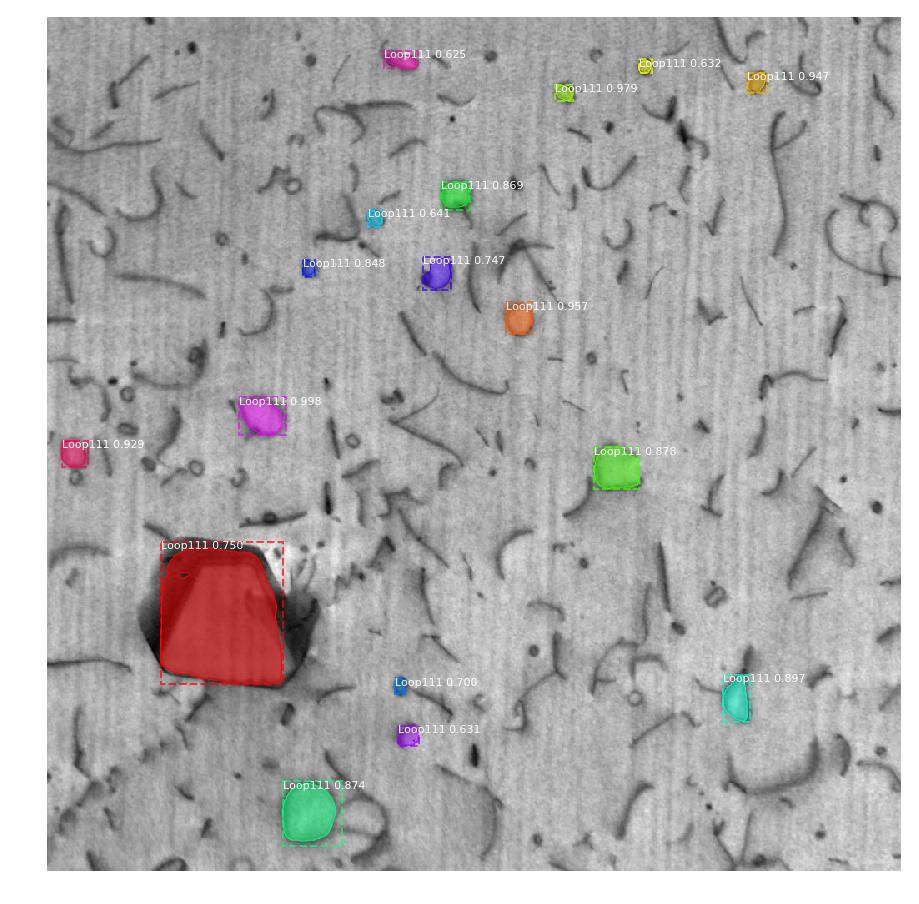

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map8_70kx_onzap_CL4100.txt
[[455 230 500 286]
 [ 80 609  99 631]
 [341 550 379 581]
 [ 65 840  89 863]
 [507  17 539  48]
 [788 811 844 843]
 [515 656 565 710]
 [916 282 993 353]
 [196 472 230 507]
 [290 307 310 321]
 [628 136 799 282]
 [286 450 326 484]
 [792 417 811 429]
 [230 384 250 401]
 [ 49 710  66 725]
 [849 420 873 446]
 [ 39 404  60 444]]
map5_70kx.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -121.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


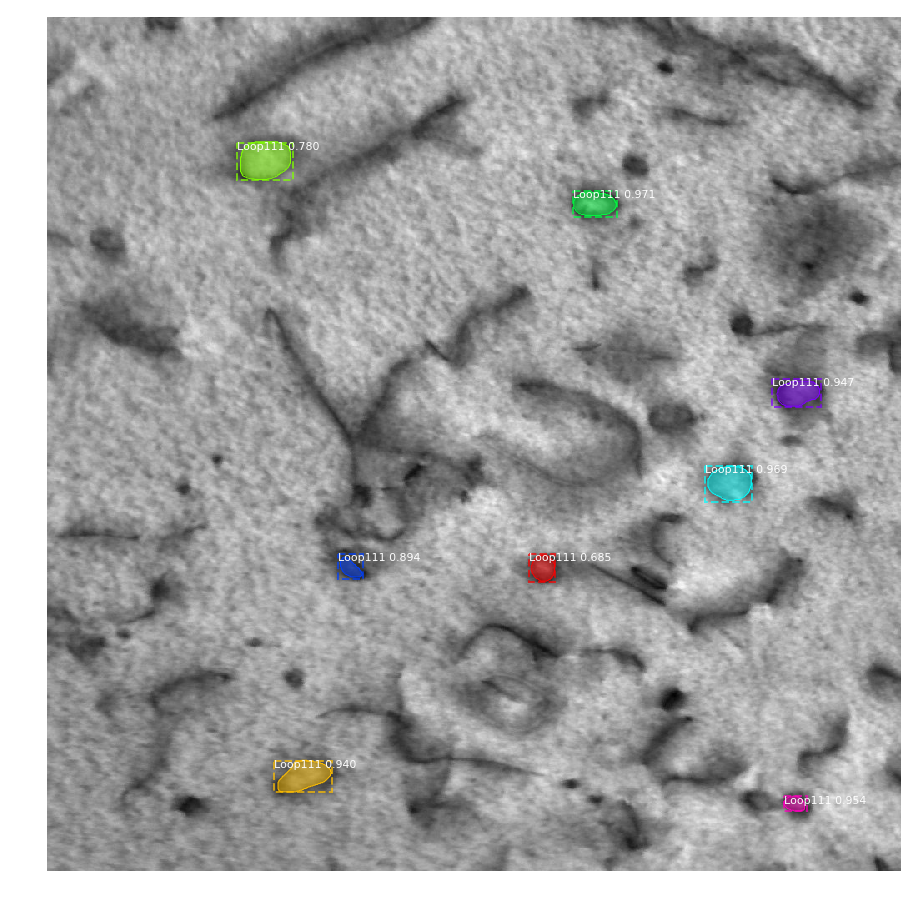

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map5_70kx.txt
[[207 630 238 683]
 [537 789 581 845]
 [934 884 952 912]
 [433 869 467 928]
 [891 272 929 341]
 [643 349 673 379]
 [149 227 194 294]
 [643 578 677 609]]
map4_70kx.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


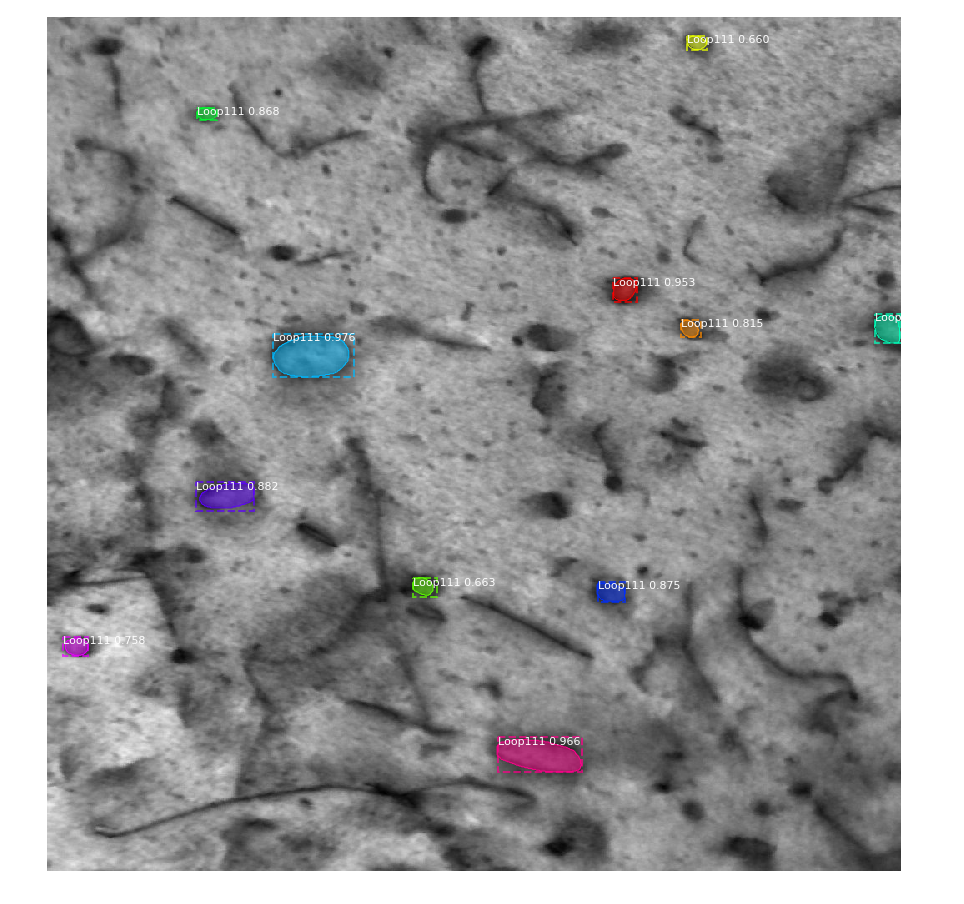

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map4_70kx.txt
[[ 379  270  431  368]
 [ 863  540  905  641]
 [ 312  679  340  707]
 [ 557  178  591  248]
 [ 676  660  700  693]
 [ 107  179  122  203]
 [ 355  993  390 1023]
 [ 362  760  383  784]
 [ 742   19  765   49]
 [ 672  438  694  467]
 [  21  767   38  791]]
map6_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -122.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


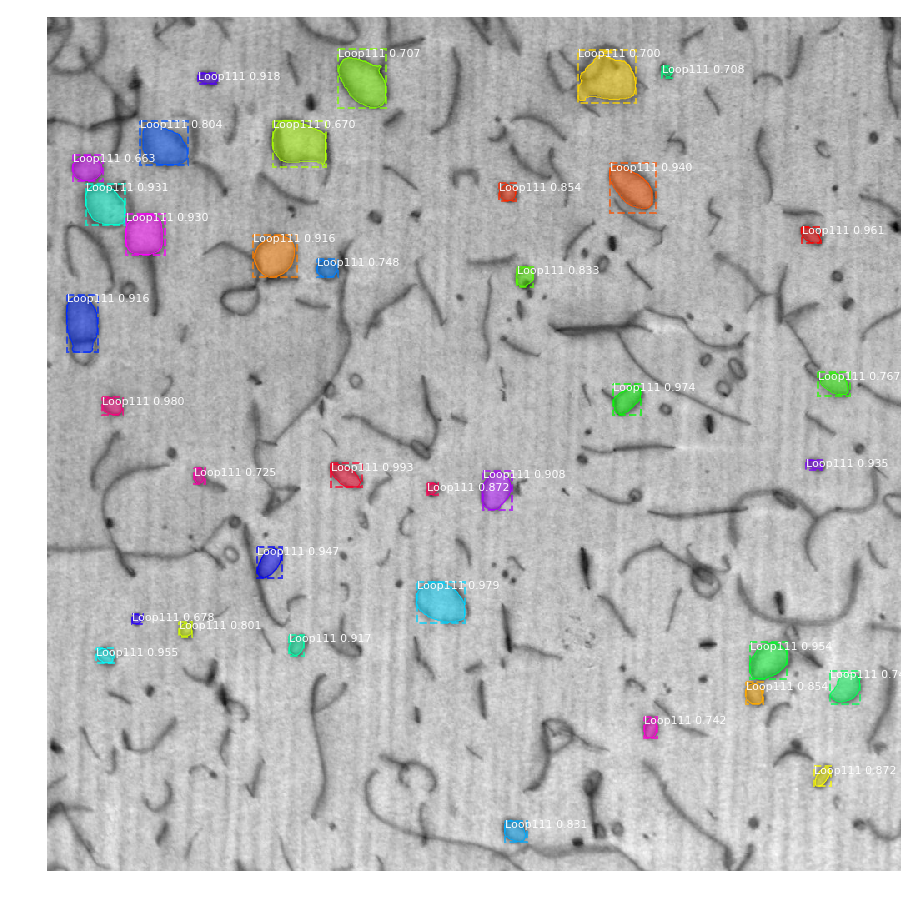

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map6_70kx_onzap_CL4100.txt
[[534 340 563 377]
 [455  65 476  91]
 [676 443 726 501]
 [439 678 476 712]
 [250 905 270 928]
 [756  58 774  80]
 [749 843 793 888]
 [635 251 672 281]
 [174 675 234 730]
 [530 910 542 930]
 [199  46 248  93]
 [235  94 284 141]
 [ 65 180  79 204]
 [740 290 765 308]
 [332  23 401  61]
 [260 247 311 299]
 [543 522 590 557]
 [558 455 572 468]
 [898 920 922 940]
 [198 542 219 562]
 [797 838 823 859]
 [298 563 322 583]
 [963 549 989 575]
 [123 111 176 168]
 [724 158 742 173]
 [425 925 453 963]
 [289 323 311 349]
 [783 939 823 975]
 [838 716 864 731]
 [540 176 559 189]
 [ 57 737  71 749]
 [ 37 349 108 406]
 [ 38 636 102 706]
 [715 101 727 114]
 [123 270 179 334]
 [164  30 195  66]]
map4_70kx_onzap_CL4100.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -121.70000  max:  151.10000 

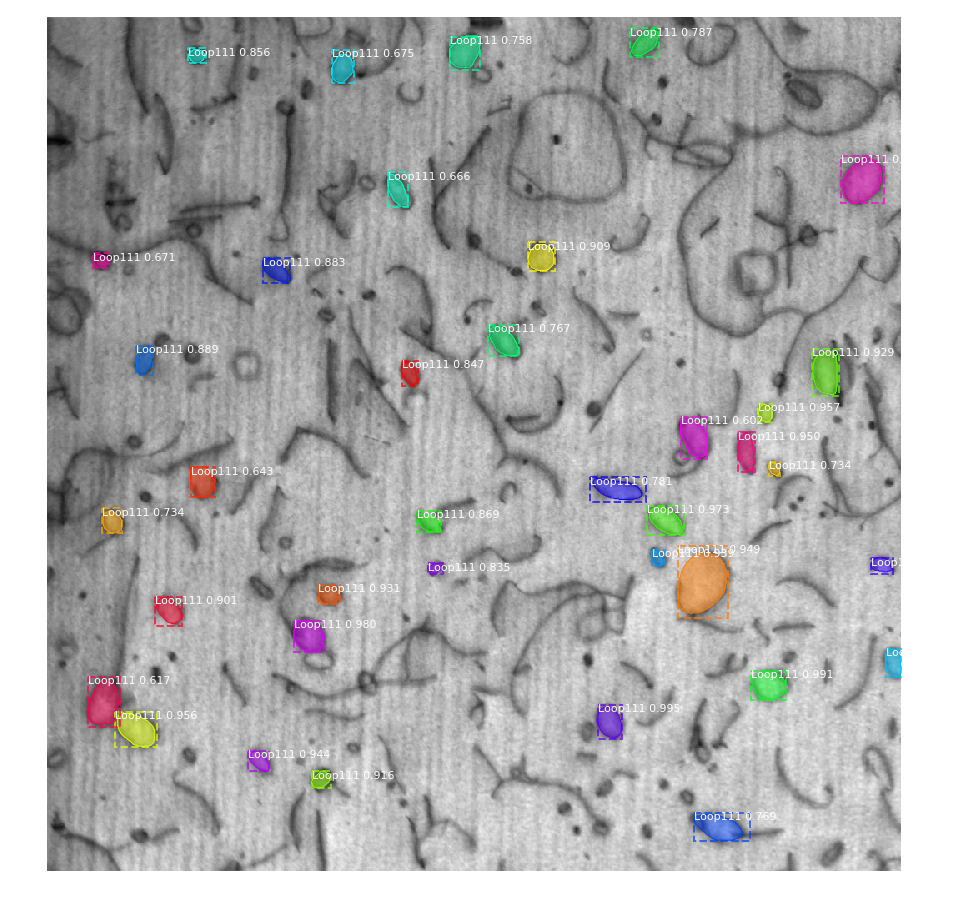

/srv/home/whao/NextGen/new_debug/run/run1/samples/generated/map4_70kx_onzap_CL4100.txt
[[ 824  660  865  689]
 [ 783  844  818  886]
 [ 165  952  222 1004]
 [ 723  296  761  332]
 [ 585  720  620  764]
 [ 463  853  485  870]
 [ 832   81  875  131]
 [ 497  829  544  849]
 [ 633  757  720  817]
 [ 879  241  904  266]
 [ 638  725  657  741]
 [ 680  324  703  351]
 [ 397  918  453  950]
 [ 904  317  924  340]
 [ 269  577  303  609]
 [ 694  129  729  161]
 [ 393  106  428  126]
 [ 757 1006  790 1024]
 [ 288  258  318  291]
 [ 591  443  617  472]
 [  36  169   53  190]
 [ 411  425  441  444]
 [ 648  988  667 1015]
 [ 654  457  667  474]
 [  12  699   46  734]
 [ 551  651  580  718]
 [ 954  776  987  843]
 [ 368  529  405  566]
 [  22  483   62  519]
 [ 532  866  549  879]
 [ 588   65  618   89]
 [  38  341   78  368]
 [ 282   55  300   74]
 [ 185  409  226  433]
 [ 539  172  575  201]
 [ 790   49  851   87]
 [ 478  760  529  792]]


In [5]:
# Load a random image from the images folder

files = os.listdir(IMAGE_DIR)

for i in range(len(files)): 

    if files[i] == ".DS_Store":

        continue

    print(files[i])

    line = files[i]

    image = skimage.io.imread(os.path.join(IMAGE_DIR, files[i]))


    ####################################################

    image_rgb = color.gray2rgb(image) 

    #make the input with 3 channels instead of 1

    ####################################################


    # Run detection

    results = model.detect([image_rgb], verbose=1)


    # Visualize results

    r = results[0]

    visualize.display_instances(image_rgb, r['rois'], r['masks'], r['class_ids'], 

                                class_names, r['scores'])

    outfile = ROOT_DIR + "/samples/" + 'generated/' + line[:-4] + '.txt'

    print(outfile)
    f = open(outfile,mode = 'w+')
#     f = open("bounding_output_box.txt","w+")

    list1 = r['rois']

    # print(list1[0])

    for j in range(len(list1)):

        f.write(str(list1[j]).replace("[","").replace("]","").lstrip(' '))

        f.write("\n")

    print(list1)

    f.close()

   

